In [1]:
import numpy as np
import matplotlib.pyplot as plt
import mdtraj as md
import nglview as ngl
import block
import os
import pickle as pkl
from scipy import stats
from scipy.optimize import curve_fit
from sklearn.linear_model import LinearRegression
import multiprocessing as mp
errmethod = 'hline'
DC = plt.rcParams['axes.prop_cycle'].by_key()['color']

In [2]:
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

new_cmap = [ '#1F78B4', '#E31A1C', '#8660AF', '#FF7F50', '#17A589', '#AF7AC5']
rtg_r = LinearSegmentedColormap.from_list("rtg", new_cmap)
colors = rtg_r(np.linspace(0,1,6))

In [3]:
color_gradients = plt.cm.viridis(np.linspace(0,1,6))

In [4]:
MATH_type='MATHfree'
SPOP_type = 'WT'

selected_phi_limit = 0.4
Ctot_crossvalidate = 15.0

phi_limits = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

oligomersizes = np.arange(2,61,2)
concs = [5.0, 10.0, 20.0, 30.0, 40.0]

recalculate=False

reweighting_type = f'{SPOP_type}_{MATH_type}_reweighting_phieff{selected_phi_limit}'

In [5]:
os.system(f'mkdir figures/{SPOP_type}')
os.system(f'mkdir figures/{SPOP_type}/{reweighting_type}')
os.system(f'mkdir pickles/{MATH_type}')

mkdir: cannot create directory ‘figures/WT’: File exists
mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.4’: File exists
mkdir: cannot create directory ‘pickles/MATHfree’: File exists


256

# General functions

In [6]:
def get_chi2(Iaverage_sim, I_exp, err_exp):
    
    chi2 = np.average(np.square((Iaverage_sim-I_exp)/err_exp))
    
    return chi2

In [7]:
def block_err_analysis(CV, errmethod):
    ##Block error anaylsis
    
    #Trim Rg array for block error analysis
    CV = block.check(CV, multi=1)

    #Block error analysis
    blocks_stat = block.blocking(CV)

    #Choose optimal block size and find error
    if errmethod=='b3':
        corr_len, err = block.optimal_block(len(CV),blocks_stat,method="b3")
    elif errmethod=='knee_loc':
        corr_len, err = block.optimal_block(len(CV),blocks_stat,method="knee_loc",S=2.7)
    elif errmethod=='hline':
        corr_len, err = block.optimal_block(len(CV),blocks_stat,method="hline")
        
    return corr_len, err, blocks_stat

In [8]:
#Functions for saving and loading pickle files
def save_pickle(filename, pickle_obj):
    with open(filename, 'wb') as f:
        pkl.dump(pickle_obj, f)

def load_pickle(filename):
    with open(filename, 'rb') as f:
        loaded_obj = pkl.load(f)
        
    return loaded_obj

In [9]:
#Function for getting final Ka from optimization log file
def get_Ka(reweighting_type):
    Ka = np.genfromtxt(f'../Reweighting_pipeline/{reweighting_type}/optimization_global.log', usecols=(2))
    Ka = Ka[-1]
    
    return Ka

In [10]:
#Function for getting final global chi2 from optimization log file
def get_global_chi2(reweighting_type):
    chi2 = np.genfromtxt(f'../Reweighting_pipeline/{reweighting_type}/optimization_global.log', usecols=(1))
    chi2 = chi2[-1]
    
    return chi2

In [11]:
#Function for calculting oligomer concentrations with isodesmic model
def isodesmic(Ka, Ctot, oligomersizes):
    
    #Get BTB dimer conc (fully formed)
    BTBdimer_conc = Ctot/2.0
        
    C = []
    
    #Calculate monomer concentration
    conc = (2*BTBdimer_conc*Ka+1-np.sqrt(4*BTBdimer_conc*Ka+1))/(2*BTBdimer_conc*(Ka**2))
    C.append(conc)
    
    #Calculate oligomer concentrations
    for i in range(1,len(oligomersizes)):
        conc = Ka*C[i-1]*C[0]
        C.append(conc)
        
    return np.array(C)

In [12]:
#Loads SAXS intensities calculated from simulations - in BME format
def load_sim_SAXS(calc_file):
    calc_data = np.array([[float(x) for x in line.split()[1:]] for line in open(calc_file) if("#" not in line)])
    return np.array(calc_data)

In [13]:
#Loads experimental SAXS q, I and err - in BME format
def load_exp_SAXS(exp_file):
    q, I, err = np.genfromtxt(exp_file, usecols=(0,1,2), skip_header=0, unpack=True)
    return np.array(q), np.array(I), np.array(err)

In [14]:
#Takes array of Iaverages from the different oligomers and calculates volume fraction weighted average SAXS using concs and oligomersizes
def volume_average_all_SAXS(calc_data, weights, concs, oligomersizes):
    Iaverages = np.sum(calc_data*weights[:,np.newaxis].reshape(calc_data.shape[0],calc_data.shape[1],1),axis=1)
    
    volume_weights = concs*oligomersizes
    volume_weights = volume_weights/np.sum(volume_weights)

    Iaverage_all = np.sum(Iaverages*volume_weights[:,np.newaxis],axis=0)
        
    return Iaverage_all

In [15]:
#Make initial uniform weights
def uniform_weights(calc_data):
    
    weights = []
    for i in range(len(oligomersizes)):
        weights.append([1/len(calc_data[i])]*len(calc_data[i]))
    
    return np.array(weights)

In [16]:
#Fit SAXS scale and offset between simulation and expt. SAXS with linear regression
def fit_scale_offset(Iaverage_sim, I_exp, err_exp):
    #Get weight for each point based on exp error
    sample_weight=1.0/(err_exp**2)
    
    #Linear regression
    reg = LinearRegression(fit_intercept=True).fit(Iaverage_sim.reshape(-1,1),I_exp.reshape(-1,1),sample_weight=sample_weight)
    r_value = reg.score(Iaverage_sim.reshape(-1,1),I_exp.reshape(-1,1),sample_weight=sample_weight)
    slope,intercept = reg.coef_[0],reg.intercept_
    
    Iaverage_sim_fit = Iaverage_sim*slope+intercept
    
    return Iaverage_sim_fit, slope, intercept, r_value

# Choose optimal phi_limit

In [17]:
#Get global chi2 after reweighting for each phi_limit
chi2_vs_phi_limit = []

#Loop over reweightings with different phi limits
for phi_limit in phi_limits:
    #Make dir name
    reweighting_type_phi = f'{SPOP_type}_{MATH_type}_reweighting_phieff{phi_limit}'
    
    #Get final global chi2 from optimization
    chi2 = get_global_chi2(reweighting_type_phi)
    chi2_vs_phi_limit.append(chi2)

#Get chi2 for no reweighting (phi=1.0)
chi2_noreweighting = get_global_chi2(f'{SPOP_type}_{MATH_type}_noreweighting')
chi2_vs_phi_limit.append(chi2_noreweighting)
phi_limits_plot = [*phi_limits, 1.00]

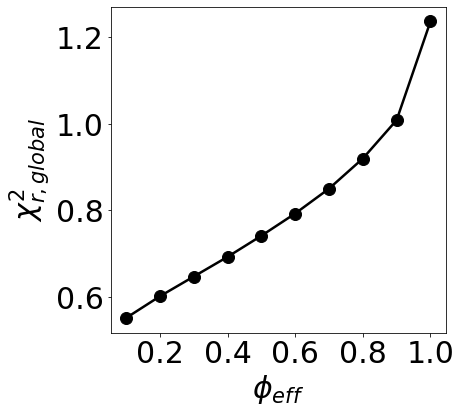

In [18]:
#Plot global chi2 vs phi_limit
fig, ax = plt.subplots(figsize=(6,6))

plt.xlabel('$\phi_{eff}$', fontsize=30)
plt.ylabel('$\chi^2_{r,global}$', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.plot(phi_limits_plot, chi2_vs_phi_limit, 'o-', markersize=12, linewidth=2.5, color='black')
plt.xticks(np.arange(0.2,1.1,0.2), fontsize=30)
    
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/chi2_vs_phieff.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/chi2_vs_phieff.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


Phi_limit is 0.1
Rew type is WT_MATHfree_reweighting_phieff0.1
Ka: 0.692235


mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.1’: File exists


Ka: 0.42 1.084885 0.692235
Chi2: 0.8356848338940328 0.9226696144834771 0.7209651464081499 0.713446823074035 1.1036126180194523
Phi_limit is 0.2
Rew type is WT_MATHfree_reweighting_phieff0.2
Ka: 0.722711


mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.2’: File exists


Ka: 0.42 1.084885 0.722711
Chi2: 0.8356848338940328 0.9226696144834771 0.730360225124707 0.7238167192982805 1.074738088948496
Phi_limit is 0.3
Rew type is WT_MATHfree_reweighting_phieff0.3
Ka: 0.749234


mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.3’: File exists


Ka: 0.42 1.084885 0.749234
Chi2: 0.8356848338940328 0.9226696144834771 0.7382549652848948 0.7344201949927938 1.0491044094332502
Phi_limit is 0.4
Rew type is WT_MATHfree_reweighting_phieff0.4
Ka: 0.775798


mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.4’: File exists


Ka: 0.42 1.084885 0.775798
Chi2: 0.8356848338940328 0.9226696144834771 0.7472127078387499 0.7462422370335059 1.0251078824919497
Phi_limit is 0.5
Rew type is WT_MATHfree_reweighting_phieff0.5
Ka: 0.805567


mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.5’: File exists


Ka: 0.42 1.084885 0.805567
Chi2: 0.8356848338940328 0.9226696144834771 0.7594358023414012 0.760655462245652 1.0021582382598893
Phi_limit is 0.6
Rew type is WT_MATHfree_reweighting_phieff0.6
Ka: 0.828637


mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.6’: File exists
/lindorffgrp-isilon/thomasen/software/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Ka: 0.42 1.084885 0.828637
Chi2: 0.8356848338940328 0.9226696144834771 0.7680984879174927 0.7725164338701204 0.9839283095283351
Phi_limit is 0.7
Rew type is WT_MATHfree_reweighting_phieff0.7
Ka: 0.870798


mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.7’: File exists


Ka: 0.42 1.084885 0.870798
Chi2: 0.8356848338940328 0.9226696144834771 0.7908050434314521 0.7954052012411501 0.9627878670809693
Phi_limit is 0.8
Rew type is WT_MATHfree_reweighting_phieff0.8
Ka: 0.880853


mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.8’: File exists


Ka: 0.42 1.084885 0.880853
Chi2: 0.8356848338940328 0.9226696144834771 0.7926356492129002 0.8010509212633192 0.9511121532745155
Phi_limit is 0.9
Rew type is WT_MATHfree_reweighting_phieff0.9
Ka: 0.94349


mkdir: cannot create directory ‘figures/WT/WT_MATHfree_reweighting_phieff0.9’: File exists


Ka: 0.42 1.084885 0.94349
Chi2: 0.8356848338940328 0.9226696144834771 0.8311516040920788 0.8373639766806747 0.933060897971963


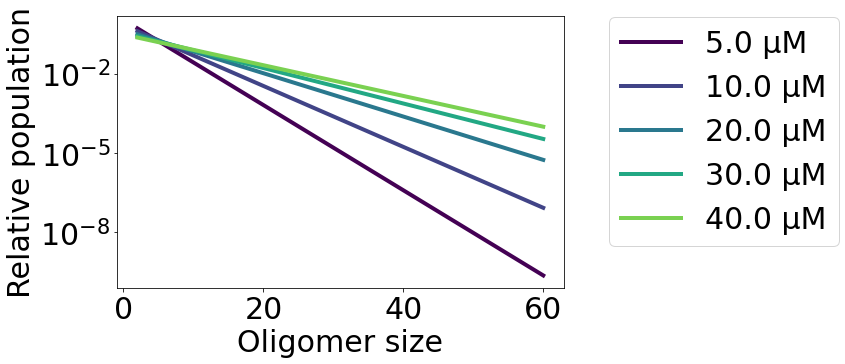

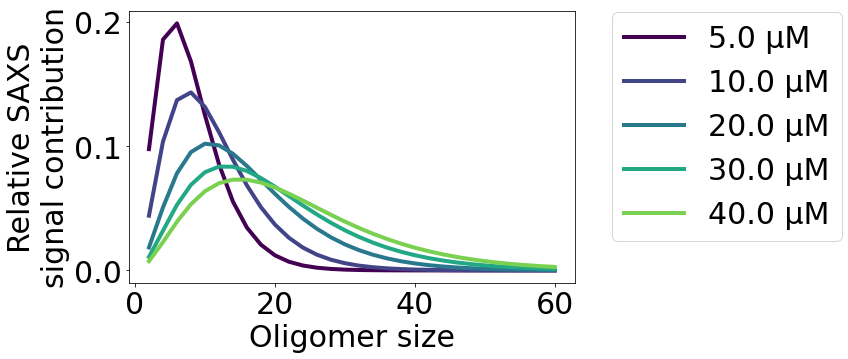

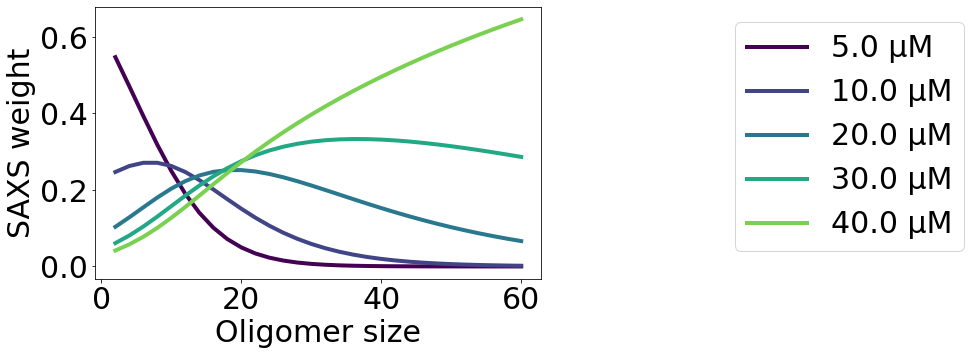

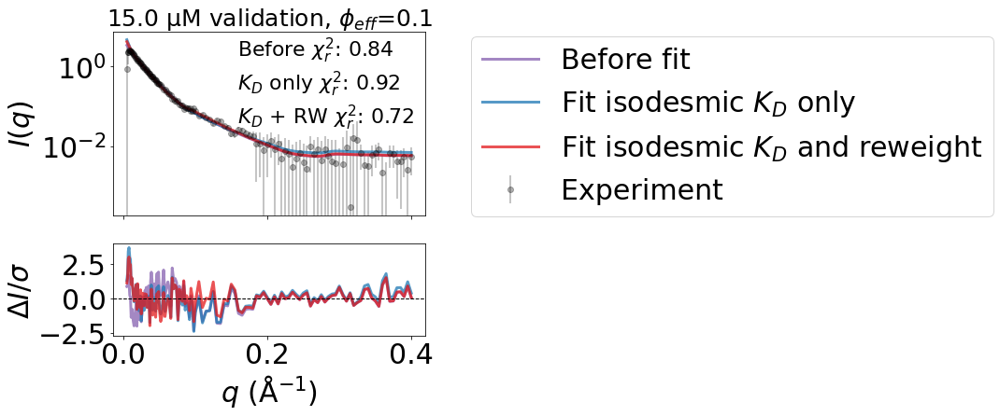

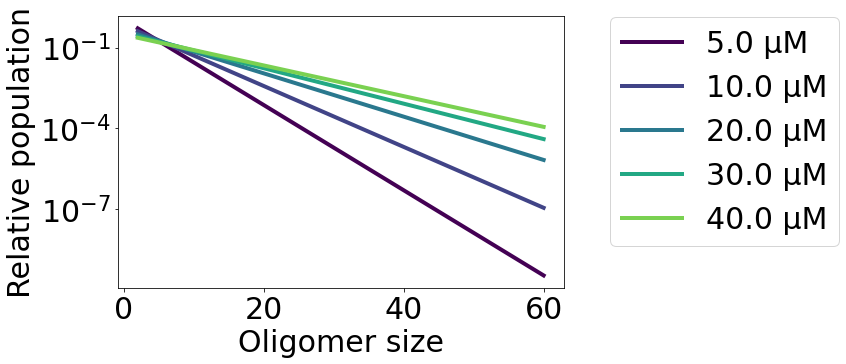

...

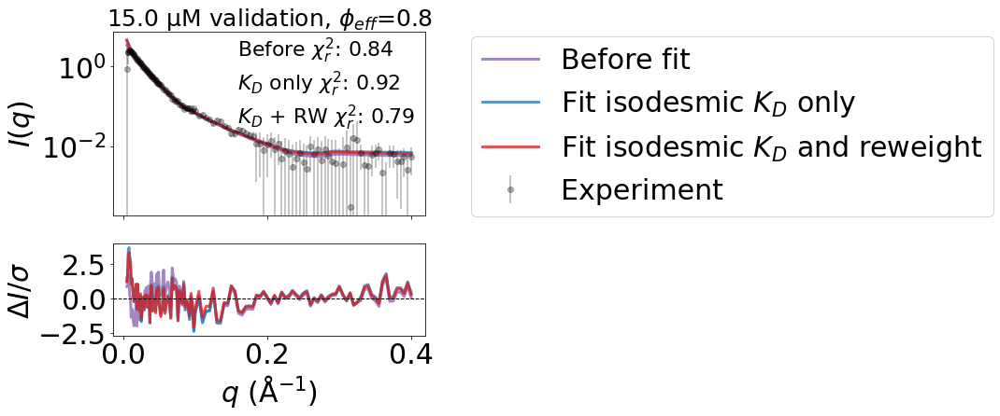

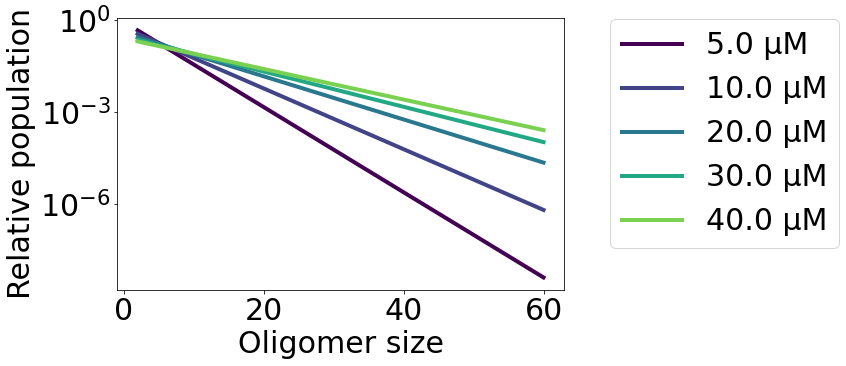

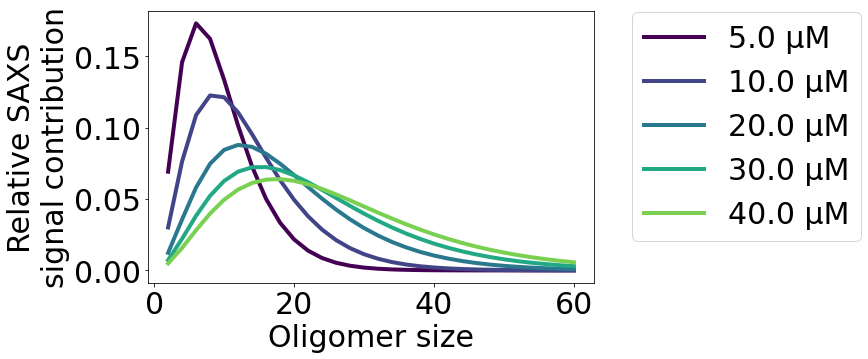

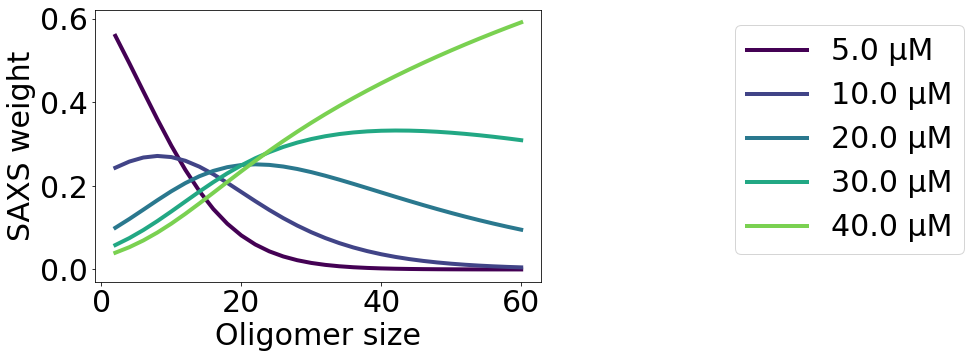

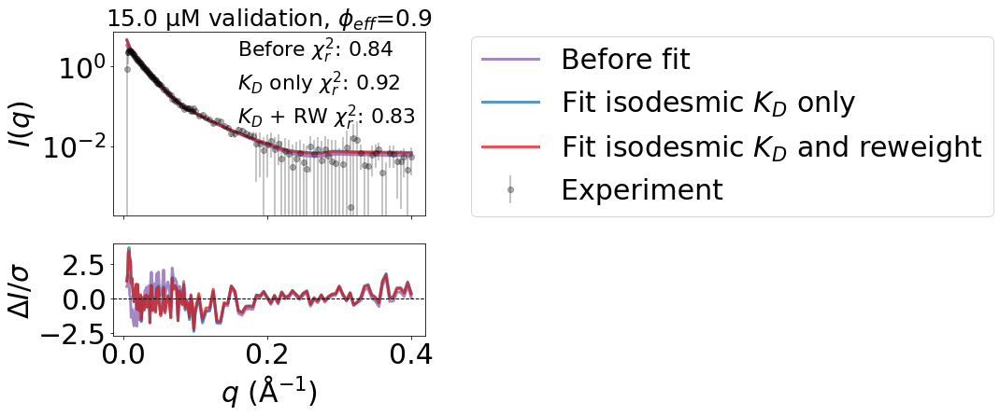

In [19]:
#Cross-validate BME weights with 15 µM SAXS data
chi2_reweighting_crossvalidation_vs_phi_uniformweights = []
chi2_reweighting_crossvalidation_vs_phi = []
chi2_reweighting_crossvalidation_vs_phi_Kanorew = []

#Loop over optimizations with different phi-limits
for phi_limit in phi_limits:
    print(f'Phi_limit is {phi_limit}')
    
    #Make output dir
    reweighting_type_phi = f'{SPOP_type}_{MATH_type}_reweighting_phieff{phi_limit}'
    os.system(f'mkdir figures/{SPOP_type}/{reweighting_type_phi}')

    print(f'Rew type is {reweighting_type_phi}')

    #Get the Ka from the optimization file
    Ka = get_Ka(reweighting_type_phi)
    print('Ka: ' + str(Ka))

    #Loop over total protein concentrations
    isodesmic_concs_relative_vs_conc = []
    SAXS_contributions_vs_conc = []
    for conc in concs:
        #Get concentrations from isodesmic model
        isodesmic_concs = isodesmic(Ka, conc, oligomersizes)
        isodesmic_concs_relative = isodesmic_concs/np.sum(isodesmic_concs)
        isodesmic_concs_relative_vs_conc.append(isodesmic_concs_relative)

        #Calculate SAXS contribution of each oligomer - proportional to particle volume squared and concentration
        SAXS_contributions = isodesmic_concs * np.square(oligomersizes)
        SAXS_contributions /= np.sum(SAXS_contributions)
        SAXS_contributions_vs_conc.append(SAXS_contributions)

    #Normalize SAXS contribution for each oligomer size, so that they sum to 1 over total protein concentrations
    SAXS_weights_vs_conc = SAXS_contributions_vs_conc/np.sum(SAXS_contributions_vs_conc, axis=0)

    #Plot oligomer populations for each concentration
    fig, ax = plt.subplots(figsize=(8,5))

    ax.set_prop_cycle('color', color_gradients)

    plt.xlabel('Oligomer size', fontsize=30)
    plt.ylabel('Relative population', fontsize=30)
    plt.semilogy()
    plt.xticks(np.arange(0, 61, 20))
    plt.tick_params(axis='both', which='major', labelsize=30)

    for i,conc in enumerate(concs):
        ax.plot(oligomersizes, isodesmic_concs_relative_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
    plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.65, 1.05))

    fig.savefig(f"figures/{SPOP_type}/{reweighting_type_phi}/oligomersize_concentrations.png", bbox_inches='tight', pad_inches=1, dpi=400)
    fig.savefig(f"figures/{SPOP_type}/{reweighting_type_phi}/oligomersize_concentrations.pdf", bbox_inches='tight', pad_inches=1, dpi=400)

    #Plot SAXS contribution for each concentration
    fig, ax = plt.subplots(figsize=(8,5))

    ax.set_prop_cycle('color', color_gradients)

    plt.xlabel('Oligomer size', fontsize=30)
    plt.ylabel('Relative SAXS\nsignal contribution', fontsize=30)

    plt.tick_params(axis='both', which='major', labelsize=30)

    for i,conc in enumerate(concs):
        ax.plot(oligomersizes, SAXS_contributions_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
    plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.05, 1.05))

    fig.savefig(f"figures/{SPOP_type}/{reweighting_type_phi}/SAXS_oligomersize_contributions.png", bbox_inches='tight', pad_inches=1, dpi=400)
    fig.savefig(f"figures/{SPOP_type}/{reweighting_type_phi}/SAXS_oligomersize_contributions.pdf", bbox_inches='tight', pad_inches=1, dpi=400)

    #Plot relative (to other concentrations) SAXS contribution for each concentration
    fig, ax = plt.subplots(figsize=(8,5))

    ax.set_prop_cycle('color', color_gradients)

    plt.xlabel('Oligomer size', fontsize=30)
    plt.ylabel('SAXS weight', fontsize=30)

    #plt.title(, fontsize=20)
    #plt.xlim(2,80)
    plt.tick_params(axis='both', which='major', labelsize=30)

    for i,conc in enumerate(concs):
        ax.plot(oligomersizes, SAXS_weights_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
    plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.40, 1.0))

    fig.savefig(f"figures/{SPOP_type}/{reweighting_type_phi}/SAXS_oligomersize_weights.png", bbox_inches='tight', pad_inches=1, dpi=400)
    fig.savefig(f"figures/{SPOP_type}/{reweighting_type_phi}/SAXS_oligomersize_weights.pdf", bbox_inches='tight', pad_inches=1, dpi=400)

    #Loop over oligomer sizes
    weights_vs_size = []
    for i,size in enumerate(oligomersizes):

        #Start running average
        weights_concavg = 0

        #Loop over total protein concentrations
        for j,conc in enumerate(concs):

            #Get weights for given size and conc - and check that they are normalized to sum to 1
            weights = np.genfromtxt(f'../Reweighting_pipeline/{reweighting_type_phi}/{conc}_uM_outfiles/weights_{size}mer.dat', usecols=(1))
            assert np.sum(weights) < 1.01 and np.sum(weights) > 0.99, 'Weights do not sum to 1 before averaging'

            #Add weights to running average 
            #weighted by how much the species contributes to SAXS at the given conc
            weights_concavg += weights*SAXS_weights_vs_conc[j][i]

        #Check that new averaged weights are normalized so they sum to 1
        assert np.sum(weights_concavg) < 1.01 and np.sum(weights_concavg) > 0.99, 'Weights do not sum to 1 after averaging'

        #Renormalize just to get closer to summing to 1
        weights_concavg /= np.sum(weights_concavg)

        #Append to list
        weights_vs_size.append(weights_concavg)

    weights_vs_size = np.array(weights_vs_size)

    # Cross-validate with 15 µM SAXS data

    #Load exp SAXS
    q, I_exp, err_exp = load_exp_SAXS(f'../Reweighting_pipeline/{reweighting_type_phi}/exp_data_15.0uM.dat')

    #Get calc SAXS data
    calc_data = []
    for oligomersize in oligomersizes:
        calc_data.append(load_sim_SAXS(f'../Reweighting_pipeline/calc_data_{MATH_type}/calc_data_{oligomersize}mer.dat'))
    calc_data = np.array(calc_data)

    #Get Ka values
    Ka_scaleoffsetonly = 0.42
    Ka_noreweighting = get_Ka(f'{SPOP_type}_{MATH_type}_noreweighting')
    Ka_reweighting = get_Ka(reweighting_type_phi)

    print('Ka:', Ka_scaleoffsetonly, Ka_noreweighting, Ka_reweighting)

    #Get concentrations with different Ka values
    concs_scaleoffsetonly = isodesmic(Ka_scaleoffsetonly, Ctot_crossvalidate, oligomersizes)
    concs_noreweighting = isodesmic(Ka_noreweighting, Ctot_crossvalidate, oligomersizes)
    concs_reweighting = isodesmic(Ka_reweighting, Ctot_crossvalidate, oligomersizes)

    #Generate uniform weights
    weights_uniform = uniform_weights(calc_data)

    #Calculate average SAXS
    Iaverage_scaleoffsetonly = volume_average_all_SAXS(calc_data, weights_uniform, concs_scaleoffsetonly, oligomersizes)
    Iaverage_noreweighting = volume_average_all_SAXS(calc_data, weights_uniform, concs_noreweighting, oligomersizes)
    Iaverage_noreweighting_Karew = volume_average_all_SAXS(calc_data, weights_uniform, concs_reweighting, oligomersizes)
    Iaverage_reweighting_Kanorew = volume_average_all_SAXS(calc_data, weights_vs_size, concs_noreweighting, oligomersizes)
    Iaverage_reweighting = volume_average_all_SAXS(calc_data, weights_vs_size, concs_reweighting, oligomersizes)

    #Fit average SAXS scale and offset with linear regression
    Iaverage_scaleoffsetonly, slope, intercept, r_value = fit_scale_offset(Iaverage_scaleoffsetonly, I_exp, err_exp)
    Iaverage_noreweighting, slope, intercept, r_value = fit_scale_offset(Iaverage_noreweighting, I_exp, err_exp)
    Iaverage_noreweighting_Karew, slope, intercept, r_value = fit_scale_offset(Iaverage_noreweighting_Karew, I_exp, err_exp)
    Iaverage_reweighting_Kanorew, slope, intercept, r_value = fit_scale_offset(Iaverage_reweighting_Kanorew, I_exp, err_exp)
    Iaverage_reweighting, slope, intercept, r_value = fit_scale_offset(Iaverage_reweighting, I_exp, err_exp)

    #Get chi2
    chi2_scaleoffsetonly = get_chi2(Iaverage_scaleoffsetonly, I_exp, err_exp)
    chi2_noreweighting = get_chi2(Iaverage_noreweighting, I_exp, err_exp)
    chi2_noreweighting_Karew = get_chi2(Iaverage_noreweighting_Karew, I_exp, err_exp)
    chi2_reweighting_Kanorew = get_chi2(Iaverage_reweighting_Kanorew, I_exp, err_exp)
    chi2_reweighting = get_chi2(Iaverage_reweighting, I_exp, err_exp)

    #Append to list for later plot
    chi2_reweighting_crossvalidation_vs_phi.append(chi2_reweighting)
    chi2_reweighting_crossvalidation_vs_phi_uniformweights.append(chi2_noreweighting_Karew)
    chi2_reweighting_crossvalidation_vs_phi_Kanorew.append(chi2_reweighting_Kanorew)

    if phi_limit == phi_limits[-1]:
        chi2_reweighting_crossvalidation_vs_phi.append(chi2_noreweighting)
        chi2_reweighting_crossvalidation_vs_phi_uniformweights.append(chi2_noreweighting)
        chi2_reweighting_crossvalidation_vs_phi_Kanorew.append(chi2_noreweighting)
            
    print('Chi2:', chi2_scaleoffsetonly, chi2_noreweighting, chi2_reweighting, chi2_noreweighting_Karew, chi2_reweighting_Kanorew)

    #Calculate residuals
    residuals_scaleoffsetonly = (I_exp-Iaverage_scaleoffsetonly)/err_exp
    residuals_noreweighting = (I_exp-Iaverage_noreweighting)/err_exp
    residuals_noreweighting_Karew = (I_exp-Iaverage_noreweighting_Karew)/err_exp
    residuals_reweighting_Kanorew = (I_exp-Iaverage_reweighting_Kanorew)/err_exp
    residuals_reweighting = (I_exp-Iaverage_reweighting)/err_exp
        
    #Plot SAXS
    fig, ax = plt.subplots(figsize = (6,6), nrows=2, sharex='col', sharey='row', gridspec_kw={'height_ratios': [4, 2]})

    ax[0].set_title(f'{Ctot_crossvalidate} µM validation, $\phi_{{eff}}$={phi_limit}', fontsize=25)

    ax[0].errorbar(q, I_exp, yerr=err_exp, fmt='o', markersize=6, color='black', alpha=0.3, label='Experiment')
    ax[0].plot(q, Iaverage_scaleoffsetonly, linewidth=3, label="Before fit", alpha=0.75, color=colors[2])
    ax[0].plot(q, Iaverage_noreweighting, linewidth=3, label="Fit isodesmic $K_D$ only", alpha=0.75, color=colors[0])
    ax[0].plot(q, Iaverage_reweighting, linewidth=3, label="Fit isodesmic $K_D$ and reweight", alpha=0.75, color=colors[1])
    ax[0].semilogy()
    ax[0].set_ylabel('$I(q)$', fontsize=30)
    ax[0].legend(fontsize=30, ncol=1, bbox_to_anchor=(1.1, 1.05))
    ax[0].text(0.40,0.50, f'Before $χ^2_r$: {chi2_scaleoffsetonly:.2f} \n$K_D$ only $χ^2_r$: {chi2_noreweighting:.2f} \n$K_D$ + RW $χ^2_r$: {chi2_reweighting:.2f}', fontsize=22, transform=ax[0].transAxes)

    for j in range(len(ax)):
        ax[j].tick_params(axis='both', which='major', labelsize=30)

    ax[1].plot(q, -residuals_scaleoffsetonly, linewidth=3, color= colors[2], alpha=0.75)
    ax[1].plot(q, -residuals_noreweighting, linewidth=3, color= colors[0], alpha=0.75)
    ax[1].plot(q, -residuals_reweighting, linewidth=3, color= colors[1], alpha=0.75)

    ax[1].set_ylabel('$ΔI/σ$', fontsize=30)
    ax[1].set_xlabel('$q$ (Å$^{-1}$)', fontsize=30)
    ax[1].axhline(0, ls='--', linewidth=1, color='black')

    fig.savefig(f"figures/{SPOP_type}/{reweighting_type_phi}/SAXS_fit_crossvalidation_{Ctot_crossvalidate}uM_testphi.png", bbox_inches='tight', pad_inches=1)
    fig.savefig(f"figures/{SPOP_type}/{reweighting_type_phi}/SAXS_fit_crossvalidation_{Ctot_crossvalidate}uM_testphi.pdf", bbox_inches='tight', pad_inches=1)

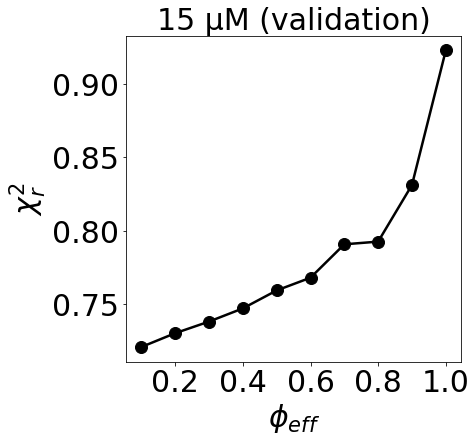

In [20]:
#Plot chi2 to cross-validation SAXS vs phi limit
phi_limits_plot = [*phi_limits, 1.00]

fig, ax = plt.subplots(figsize=(6,6))

plt.title('15 µM (validation)', fontsize=30)
plt.xlabel('$\phi_{eff}$', fontsize=30)
plt.ylabel(f'$\chi^2_r$', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.xticks(np.arange(0.2,1.1,0.2), fontsize=30)

plt.plot(phi_limits_plot, chi2_reweighting_crossvalidation_vs_phi, 'o-', markersize=12, linewidth=2.5, color='black', label='Fit isodesmic $K_D$ and reweight')

fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/chi2_crossvalidation_vs_phieff.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/chi2_crossvalidation_vs_phieff.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


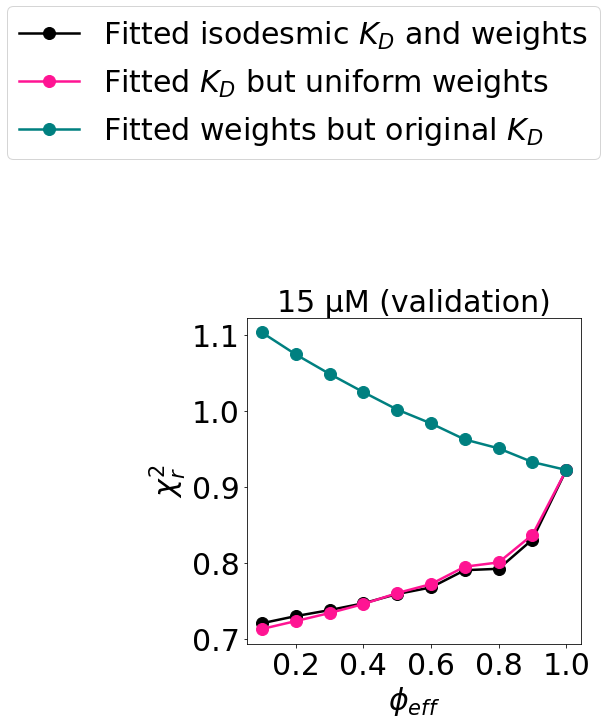

In [21]:
#Plot chi2 to cross-validation SAXS vs phi limit (also with weights only or Ka only)
phi_limits_plot = [*phi_limits, 1.00]

fig, ax = plt.subplots(figsize=(6,6))

plt.title('15 µM (validation)', fontsize=30)
plt.xlabel('$\phi_{eff}$', fontsize=30)
plt.ylabel(f'$\chi^2_r$', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.xticks(np.arange(0.2,1.1,0.2), fontsize=30)

plt.plot(phi_limits_plot, chi2_reweighting_crossvalidation_vs_phi, 'o-', markersize=12, linewidth=2.5, color='black', label='Fitted isodesmic $K_D$ and weights')
plt.plot(phi_limits_plot, chi2_reweighting_crossvalidation_vs_phi_uniformweights, 'o-', markersize=12, linewidth=2.5, color='deeppink', label='Fitted $K_D$ but uniform weights')
plt.plot(phi_limits_plot, chi2_reweighting_crossvalidation_vs_phi_Kanorew, 'o-', markersize=12, linewidth=2.5, color='teal', label='Fitted weights but original $K_D$')

plt.legend(fontsize=30, bbox_to_anchor=(1.1, 2.0))

fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/chi2_crossvalidation_vs_phieff_testKaandweights.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/chi2_crossvalidation_vs_phieff_testKaandweights.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


# Isodesmic distribution and SAXS contributions for starting Ka

In [22]:
#Initial Ka
Ka = 0.42

#Loop over total protein concentrations
isodesmic_concs_relative_vs_conc = []
SAXS_contributions_vs_conc = []
for conc in concs:
    #Get concentrations from isodesmic model
    isodesmic_concs = isodesmic(Ka, conc, oligomersizes)
    isodesmic_concs_relative = isodesmic_concs/np.sum(isodesmic_concs)
    isodesmic_concs_relative_vs_conc.append(isodesmic_concs_relative)
    
    #Calculate SAXS contribution of each oligomer - proportional to particle volume squared and concentration
    SAXS_contributions = isodesmic_concs * np.square(oligomersizes)
    SAXS_contributions /= np.sum(SAXS_contributions)
    SAXS_contributions_vs_conc.append(SAXS_contributions)
    
#Normalize SAXS contribution for each oligomer size, so that they sum to 1 over total protein concentrations
SAXS_weights_vs_conc = SAXS_contributions_vs_conc/np.sum(SAXS_contributions_vs_conc, axis=0)

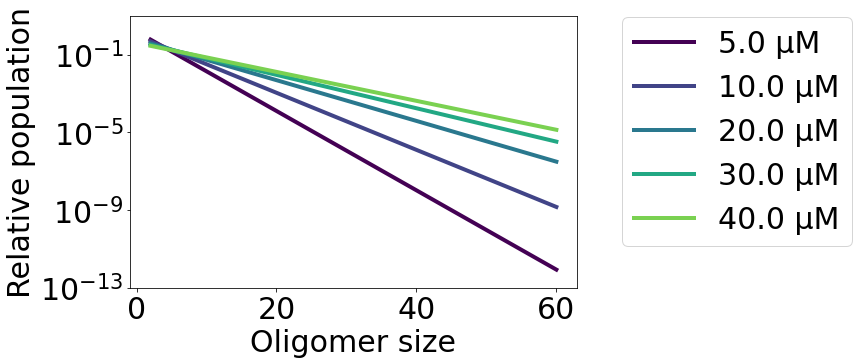

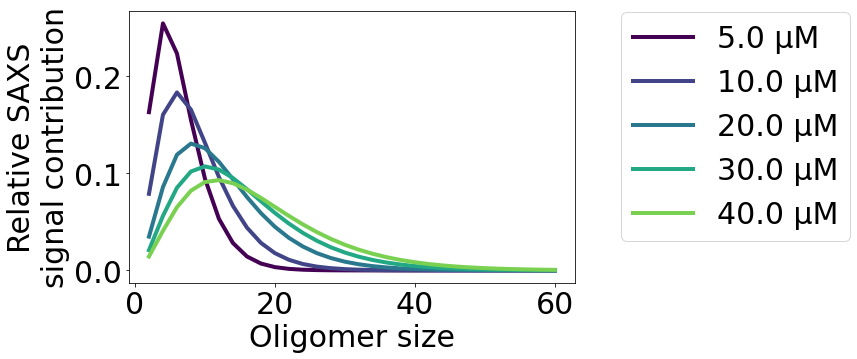

In [23]:
#Plot oligomer populations
fig, ax = plt.subplots(figsize=(8,5))

ax.set_prop_cycle('color', color_gradients)

plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('Relative population', fontsize=30)
plt.ylim(10**-13,10.0)
plt.tick_params(axis='both', which='major', labelsize=30)

for i,conc in enumerate(concs):
    ax.plot(oligomersizes, isodesmic_concs_relative_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.65, 1.05))

plt.semilogy()
plt.xticks(np.arange(0, 61, 20))

fig.savefig(f"figures/oligomersize_concentrations_initialKa.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/oligomersize_concentrations_initialKa.pdf", bbox_inches='tight', pad_inches=1, dpi=400)

#Plot SAXS contribution for each concentration
fig, ax = plt.subplots(figsize=(8,5))

ax.set_prop_cycle('color', color_gradients)

plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('Relative SAXS\nsignal contribution', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

for i,conc in enumerate(concs):
    ax.plot(oligomersizes, SAXS_contributions_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.65, 1.05))
    
fig.savefig(f"figures/SAXS_oligomersize_contributions_initialKa.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/SAXS_oligomersize_contributions_initialKa.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


# Plot isodesmic distribution and SAXS contribution for fits

0.42
1.084885
0.775798


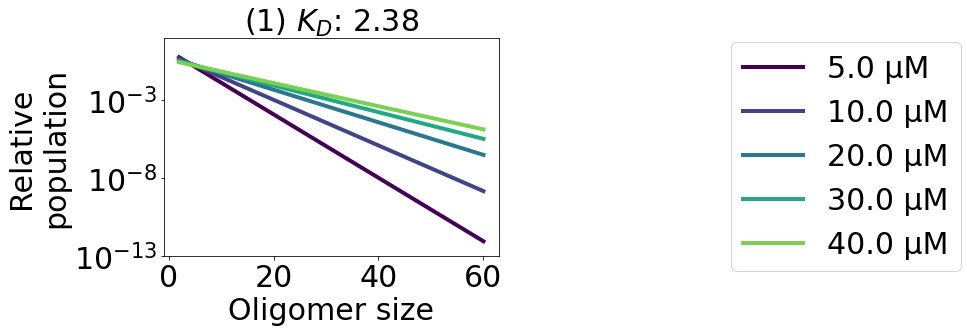

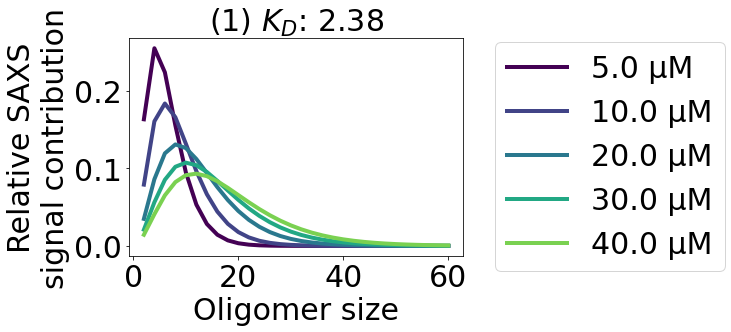

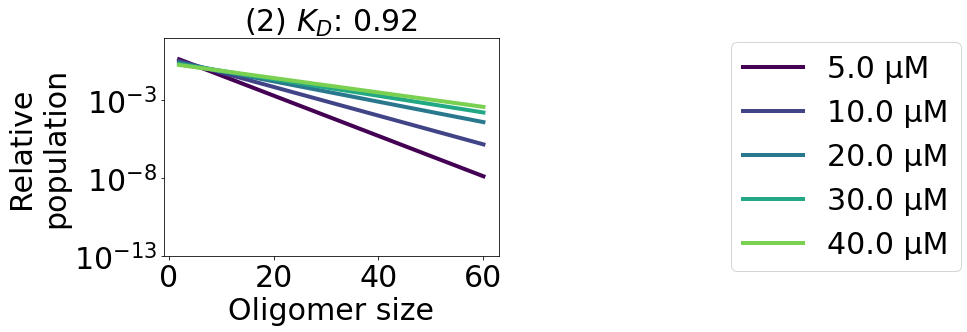

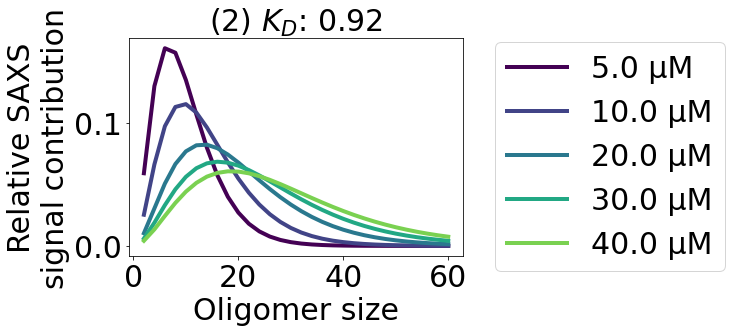

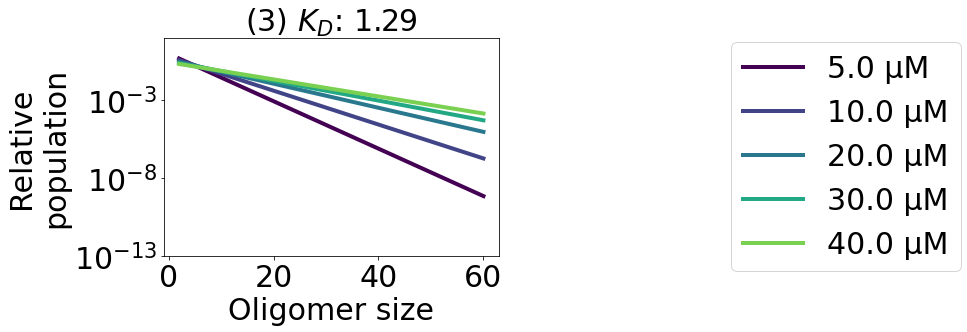

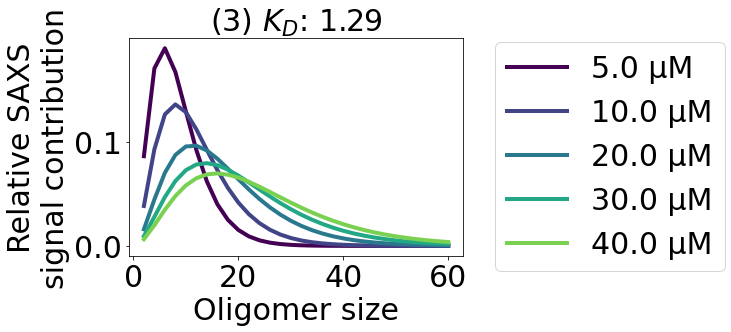

In [24]:
#Initial Ka
#Get Ka values
Ka_scaleoffsetonly = 0.42
Ka_noreweighting = get_Ka(f'{SPOP_type}_{MATH_type}_noreweighting')
Ka_reweighting = get_Ka(reweighting_type)

for c,Ka_type in enumerate([Ka_scaleoffsetonly, Ka_noreweighting, Ka_reweighting]):
    
    print(str(Ka_type))
    
    #Loop over total protein concentrations
    isodesmic_concs_relative_vs_conc = []
    SAXS_contributions_vs_conc = []
    for conc in concs:
        #Get concentrations from isodesmic model
        isodesmic_concs = isodesmic(Ka_type, conc, oligomersizes)
        isodesmic_concs_relative = isodesmic_concs/np.sum(isodesmic_concs)
        isodesmic_concs_relative_vs_conc.append(isodesmic_concs_relative)

        #Calculate SAXS contribution of each oligomer - proportional to particle volume squared and concentration
        SAXS_contributions = isodesmic_concs * np.square(oligomersizes)
        SAXS_contributions /= np.sum(SAXS_contributions)
        SAXS_contributions_vs_conc.append(SAXS_contributions)

    #Normalize SAXS contribution for each oligomer size, so that they sum to 1 over total protein concentrations
    SAXS_weights_vs_conc = SAXS_contributions_vs_conc/np.sum(SAXS_contributions_vs_conc, axis=0)

    
    
    

    
    #Plot isodesmic distribution for each concentration
    fig, ax = plt.subplots(figsize=(6,4))

    plt.title(f'({c+1}) $K_D$: {(1/Ka_type):.2f}', fontsize=30)
    #plt.text(0.56,0.50, f'({c+1}) $K_D$: {(1/Ka_type):.2f}', fontsize=30)
    
    ax.set_prop_cycle('color', color_gradients)

    plt.xlabel('Oligomer size', fontsize=30)
    plt.ylabel('Relative\npopulation', fontsize=30)

    #plt.title(, fontsize=20)
    #plt.xlim(2,80)
    plt.tick_params(axis='both', which='major', labelsize=30)
    plt.semilogy()
    plt.ylim(10**-13,10.0)
    plt.xticks(np.arange(0, 61, 20))

    for i,conc in enumerate(concs):
        ax.plot(oligomersizes, isodesmic_concs_relative_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
    plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.65, 1.05))

    fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/oligomersize_concentrations_{c+1}_{Ka_type}.png", bbox_inches='tight', pad_inches=1, dpi=400)
    fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/oligomersize_concentrations_{c+1}_{Ka_type}.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


    
    
    
    
    
    #Plot SAXS contribution for each concentration
    fig, ax = plt.subplots(figsize=(6,4))
    
    plt.title(f'({c+1}) $K_D$: {(1/Ka_type):.2f}', fontsize=30)
    #plt.text(0.56,0.50, f'({c+1}) $K_D$: {(1/Ka_type):.2f}', fontsize=30)

    ax.set_prop_cycle('color', color_gradients)

    plt.xlabel('Oligomer size', fontsize=30)
    plt.ylabel('Relative SAXS\nsignal contribution', fontsize=30)

    plt.tick_params(axis='both', which='major', labelsize=30)
    #plt.yticks(np.arange(0.0, 0.175, step=0.05), fontsize=30)
    plt.xticks(np.arange(0,61,20))

    for i,conc in enumerate(concs):
        ax.plot(oligomersizes, SAXS_contributions_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
    plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.05, 1.05))

    fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/SAXS_oligomersize_contributions_{c+1}_{Ka_type}.png", bbox_inches='tight', pad_inches=1, dpi=400)
    fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/SAXS_oligomersize_contributions_{c+1}_{Ka_type}.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


# Weights

In [25]:
#Get the Ka from the optimization file

Ka = get_Ka(reweighting_type)
print('Ka: ' + str(Ka))

#Loop over total protein concentrations
isodesmic_concs_relative_vs_conc = []
SAXS_contributions_vs_conc = []
for conc in concs:
    #Get concentrations from isodesmic model
    isodesmic_concs = isodesmic(Ka, conc, oligomersizes)
    isodesmic_concs_relative = isodesmic_concs/np.sum(isodesmic_concs)
    isodesmic_concs_relative_vs_conc.append(isodesmic_concs_relative)
    
    #Calculate SAXS contribution of each oligomer - proportional to particle volume squared and concentration
    SAXS_contributions = isodesmic_concs * np.square(oligomersizes)
    SAXS_contributions /= np.sum(SAXS_contributions)
    SAXS_contributions_vs_conc.append(SAXS_contributions)
    
#Normalize SAXS contribution for each oligomer size, so that they sum to 1 over total protein concentrations
SAXS_weights_vs_conc = SAXS_contributions_vs_conc/np.sum(SAXS_contributions_vs_conc, axis=0)

Ka: 0.775798


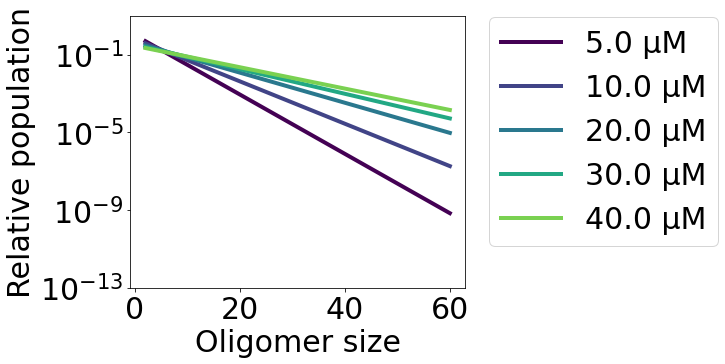

In [26]:
#Plot SAXS contribution for each concentration
fig, ax = plt.subplots(figsize=(6,5))

ax.set_prop_cycle('color', color_gradients)

plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('Relative population', fontsize=30)

#plt.title(, fontsize=20)
plt.ylim(10**-13,10.0)
plt.semilogy()
plt.xticks(np.arange(0, 61, 20))
plt.tick_params(axis='both', which='major', labelsize=30)

for i,conc in enumerate(concs):
    ax.plot(oligomersizes, isodesmic_concs_relative_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.80, 1.05))
    
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/oligomersize_concentrations.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/oligomersize_concentrations.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


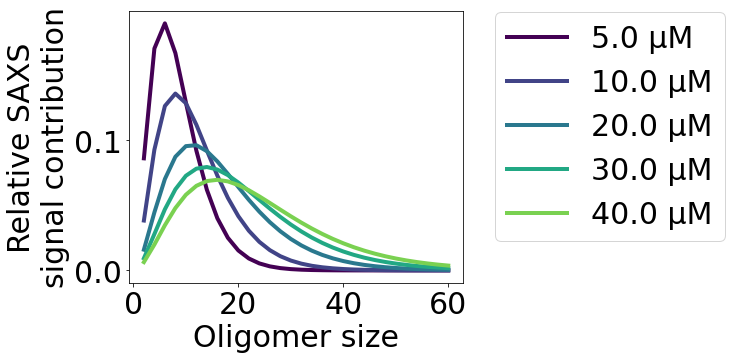

In [27]:
#Plot SAXS contribution for each concentration
fig, ax = plt.subplots(figsize=(6,5))

ax.set_prop_cycle('color', color_gradients)

plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('Relative SAXS\nsignal contribution', fontsize=30)

plt.tick_params(axis='both', which='major', labelsize=30)
#plt.yticks(np.arange(0.0, 0.175, step=0.05), fontsize=30)
#plt.yticks(fontsize=30)
plt.xticks(np.arange(0, 61, 20))

for i,conc in enumerate(concs):
    ax.plot(oligomersizes, SAXS_contributions_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.05, 1.05))
    
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/SAXS_oligomersize_contributions.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/SAXS_oligomersize_contributions.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


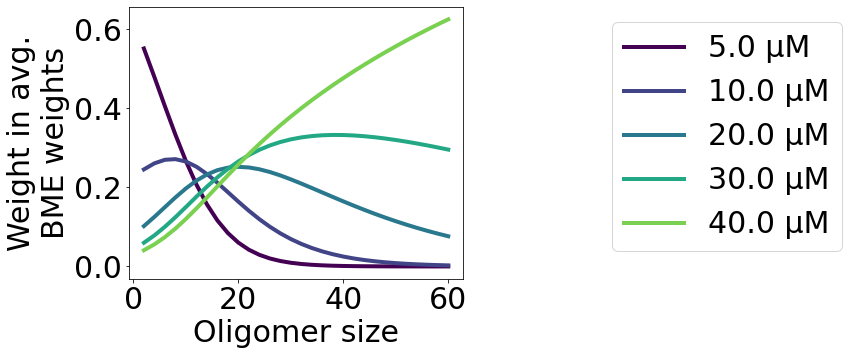

In [28]:
#Plot SAXS contribution for each concentration
fig, ax = plt.subplots(figsize=(6,5))

ax.set_prop_cycle('color', color_gradients)

plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('Weight in avg.\nBME weights', fontsize=30)

#plt.title(, fontsize=20)
#plt.xlim(2,80)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.xticks(np.arange(0, 61, 20))

for i,conc in enumerate(concs):
    ax.plot(oligomersizes, SAXS_weights_vs_conc[i], '-', markersize=12, linewidth=4, label=f'{conc} µM')
plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.40, 1.0))
    
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/SAXS_oligomersize_weights.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/SAXS_oligomersize_weights.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


/lindorffgrp-isilon/thomasen/software/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


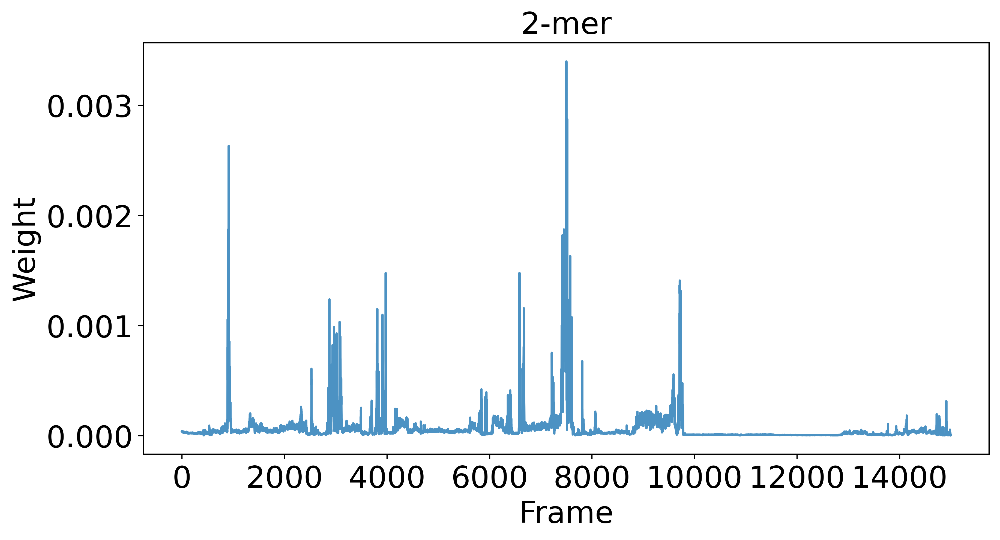

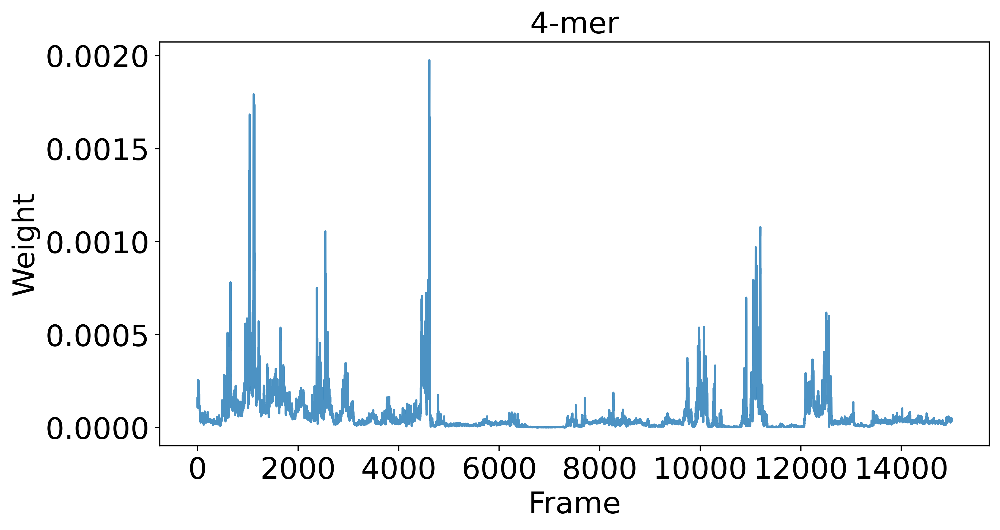

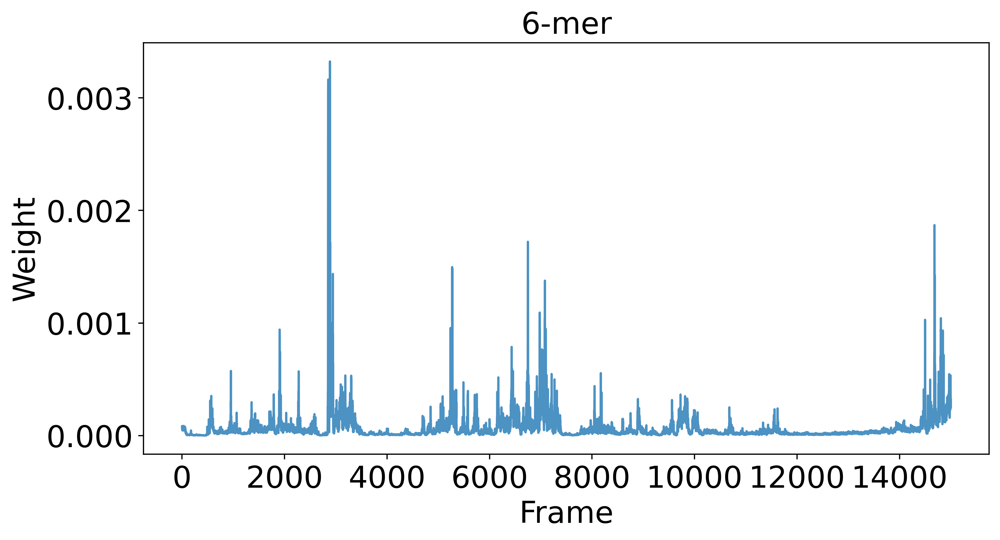

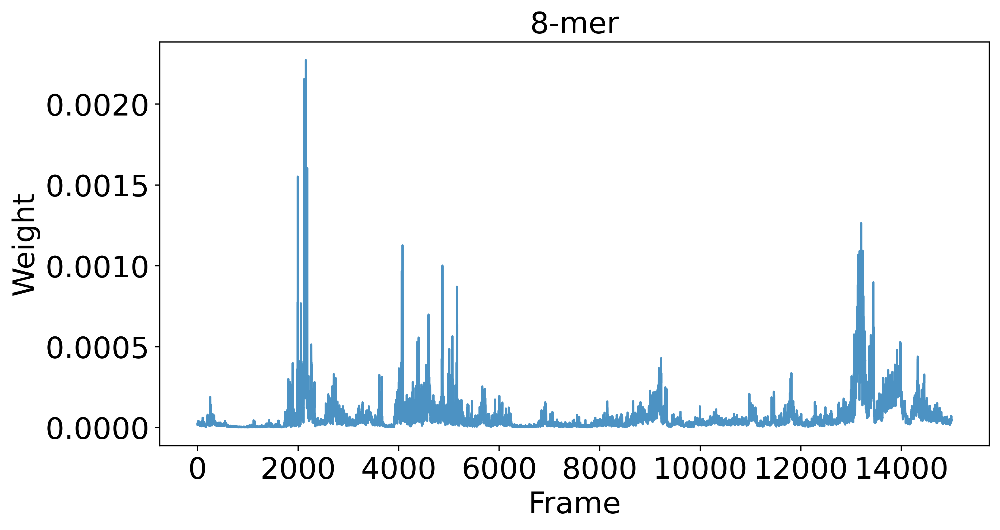

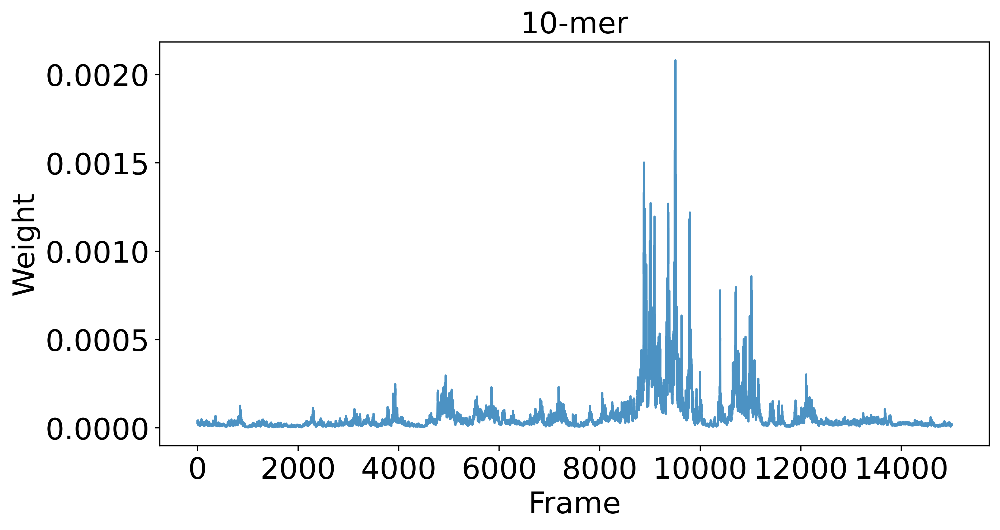

...

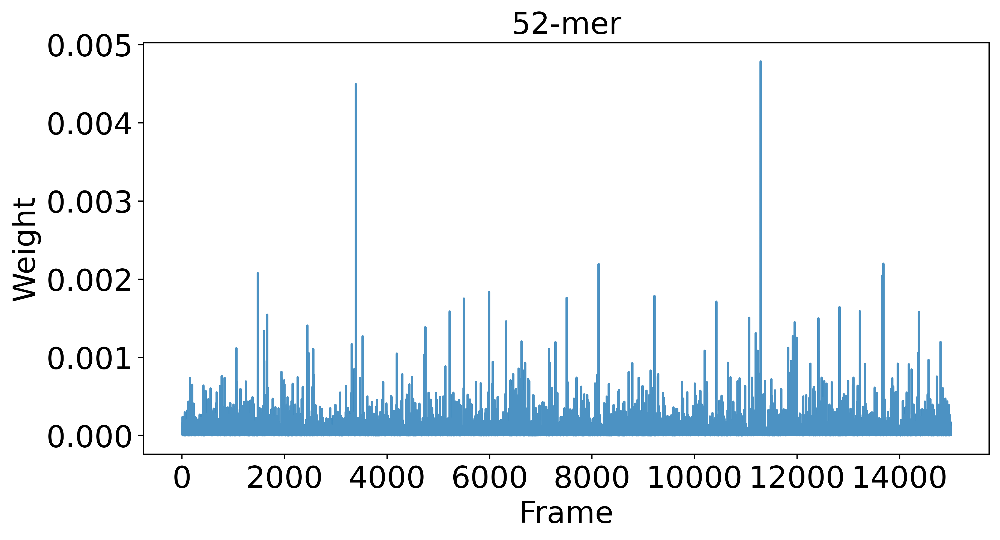

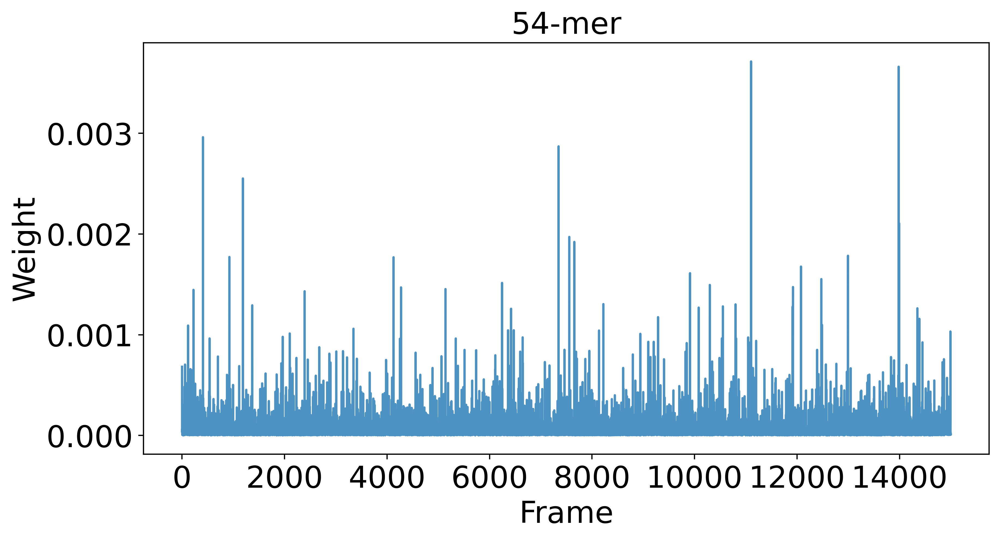

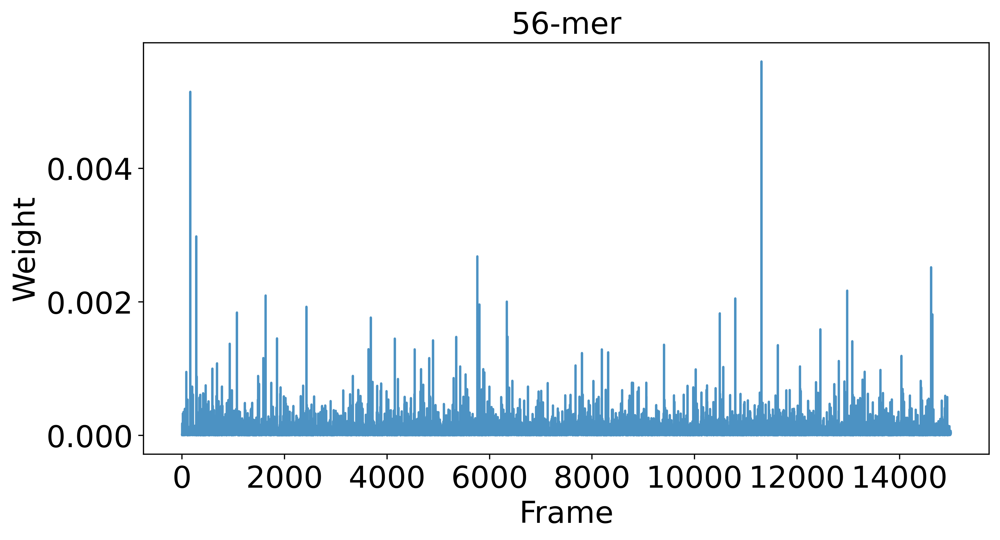

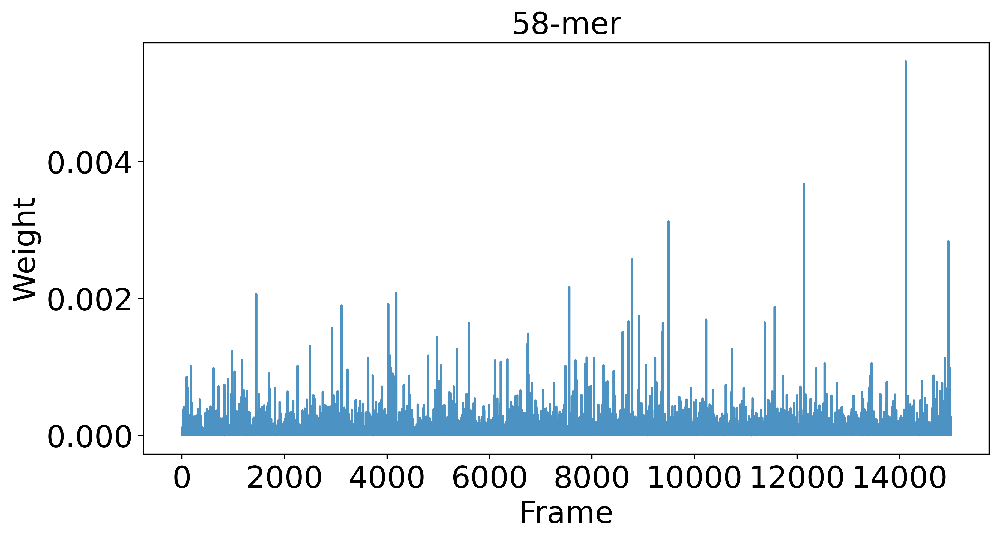

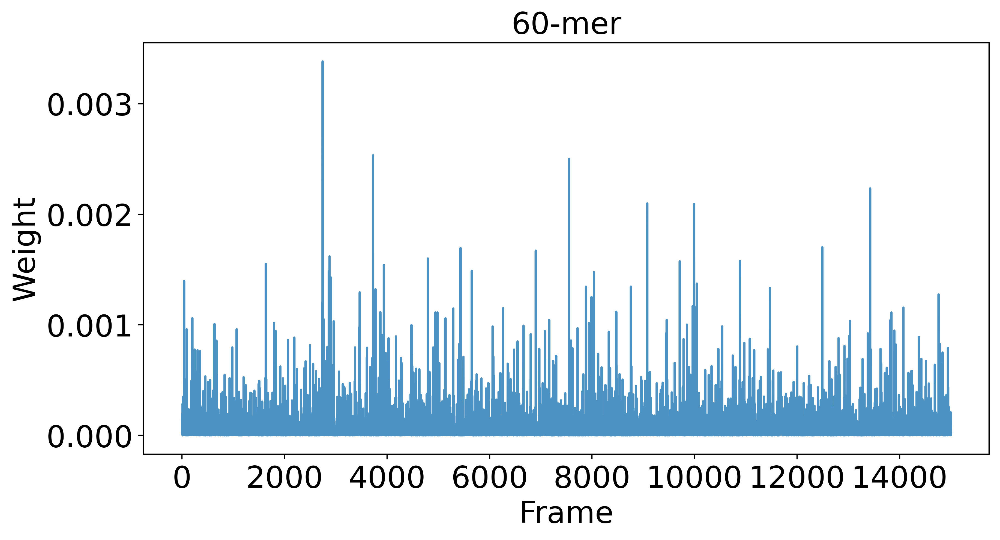

In [29]:
#Loop over oligomer sizes
weights_vs_size = []
for i,size in enumerate(oligomersizes):
    
    #Start running average
    weights_concavg = 0
    
    #Loop over total protein concentrations
    for j,conc in enumerate(concs):
        
        #Get weights for given size and conc - and check that they are normalized to sum to 1
        weights = np.genfromtxt(f'../Reweighting_pipeline/{reweighting_type}/{conc}_uM_outfiles/weights_{size}mer.dat', usecols=(1))
        assert np.sum(weights) < 1.01 and np.sum(weights) > 0.99, 'Weights do not sum to 1 before averaging'
        
        #Add weights to running average 
        #weighted by how much the species contributes to SAXS at the given conc
        weights_concavg += weights*SAXS_weights_vs_conc[j][i]
        
    #Check that new averaged weights are normalized so they sum to 1
    assert np.sum(weights_concavg) < 1.01 and np.sum(weights_concavg) > 0.99, 'Weights do not sum to 1 after averaging'
    
    #Renormalize averaged weights just to get closer to summing to 1
    weights_concavg /= np.sum(weights_concavg)
    
    #Append to list
    weights_vs_size.append(weights_concavg)
    
    #Plot weights for given oligomer size
    fig = plt.figure(figsize=(10,5), dpi=400, facecolor='w') 
    plt.ylabel('Weight', fontsize=20)
    plt.xlabel('Frame', fontsize=20)
    plt.title(f'{size}-mer', fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=20)
    
    plt.plot(weights_concavg, linewidth=1.5, alpha=0.8, label=f'{conc} µM')

    fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/weights_concavg_vs_{size}mer.png", bbox_inches='tight', pad_inches=1)

weights_vs_size = np.array(weights_vs_size)

# Rg

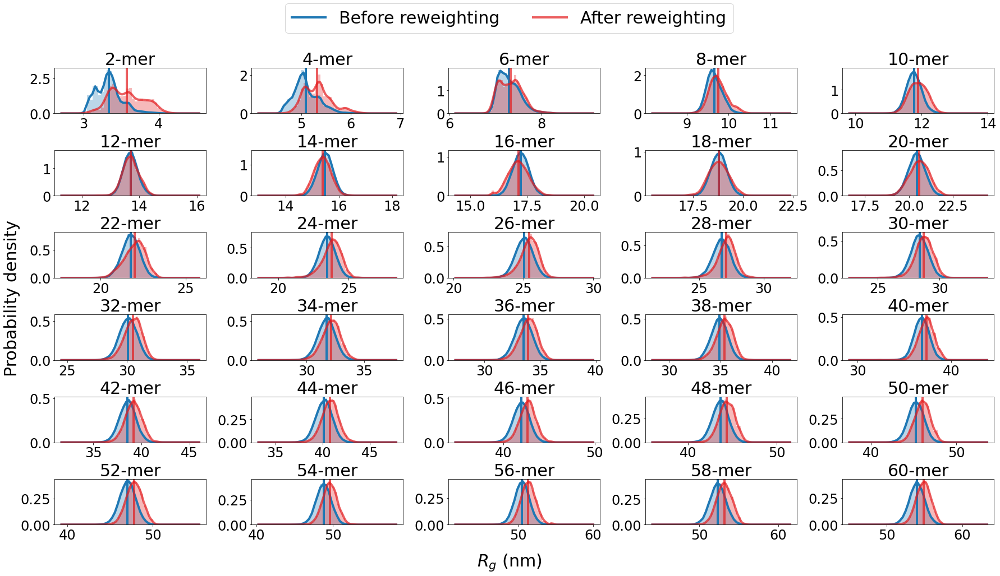

In [30]:
#Start plot
fig, ax = plt.subplots(figsize=(30,15), nrows=6, ncols=5)    
plt.subplots_adjust(hspace = 0.8, wspace=0.3)
fig.text(0.5, 0.08, '$R_g$ (nm)', ha='center', va='top', fontsize=30)
fig.text(0.09, 0.5, 'Probability density', ha='center', va='center', fontsize=30, rotation=90)

#Loop over oligomer sizes
k=0
n=0
for i,size in enumerate(oligomersizes):
    
    #Get Rg from Gromacs xvg file
    time, Rg = np.genfromtxt(f'{MATH_type}_runs/SPOP_{size}mer/Rg_gyrate_AA.xvg', usecols=(0,1), skip_header=27, unpack=True)
    
    #Plot title
    ax[k,n].set_title(f'{size}-mer', fontsize=30)
    
    #KDE without weights
    kde_x = np.linspace( np.amin(Rg)*0.9, np.amax(Rg)*1.1, num = 50 )
    kde_y = stats.gaussian_kde(Rg, bw_method = "silverman").evaluate(kde_x)
    
    #Plot distribution
    ax[k,n].hist(Rg, density=True, color=colors[0], alpha=0.3, bins=30)
    ax[k,n].plot(kde_x, kde_y, '-', linewidth=4, color=colors[0])
    #Plot averages
    if k==0 and n==0:
        ax[k,n].axvline(np.average(Rg),linewidth=4, alpha=1, color=colors[0], label='Before reweighting')
    else:
        ax[k,n].axvline(np.average(Rg),linewidth=4, alpha=1, color=colors[0])

    #KDE with weights
    kde_x = np.linspace( np.amin(Rg)*0.9, np.amax(Rg)*1.1, num = 100 )
    kde_y = stats.gaussian_kde(Rg, bw_method = "silverman", weights=weights_vs_size[i]).evaluate(kde_x)
    
    #Plot distribution (with rew)
    ax[k,n].hist(Rg, density=True, color=colors[1], alpha=0.3, bins=30, weights=weights_vs_size[i])
    ax[k,n].plot(kde_x, kde_y, '-', linewidth=4, color=colors[1], alpha=0.7)
    #Plot averages (with rew)
    if k==0 and n==0:
        ax[k,n].axvline(np.average(Rg, weights=weights_vs_size[i]),linewidth=4, alpha=0.7, color=colors[1], label='After reweighting')
    else:
        ax[k,n].axvline(np.average(Rg, weights=weights_vs_size[i]),linewidth=4, alpha=0.7, color=colors[1])
    
    ax[k,n].tick_params(axis='both', which='major', labelsize=24)
    
    #Iterate over plot panel indeces
    n+=1
    if n==5:
        n=0
        k+=1

#Add legend
fig.legend(fontsize=30, loc='upper center', bbox_to_anchor=(0.5, 1.0), ncol=2)

#Save
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/Rg_distribution.pdf", bbox_inches='tight', pad_inches=1)


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )
/lindorffgrp-isilon/thomasen/software/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40

Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Removing 1 at the bottom of each replica
Possible blocks transformations: 40



/lindorffgrp-isilon/thomasen/SPOP/28_359/Production_run/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


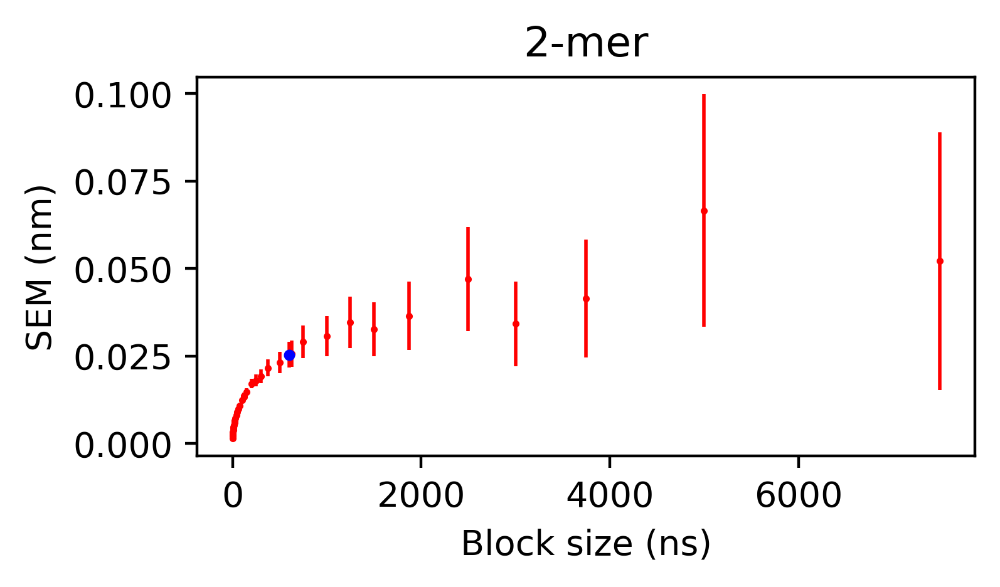

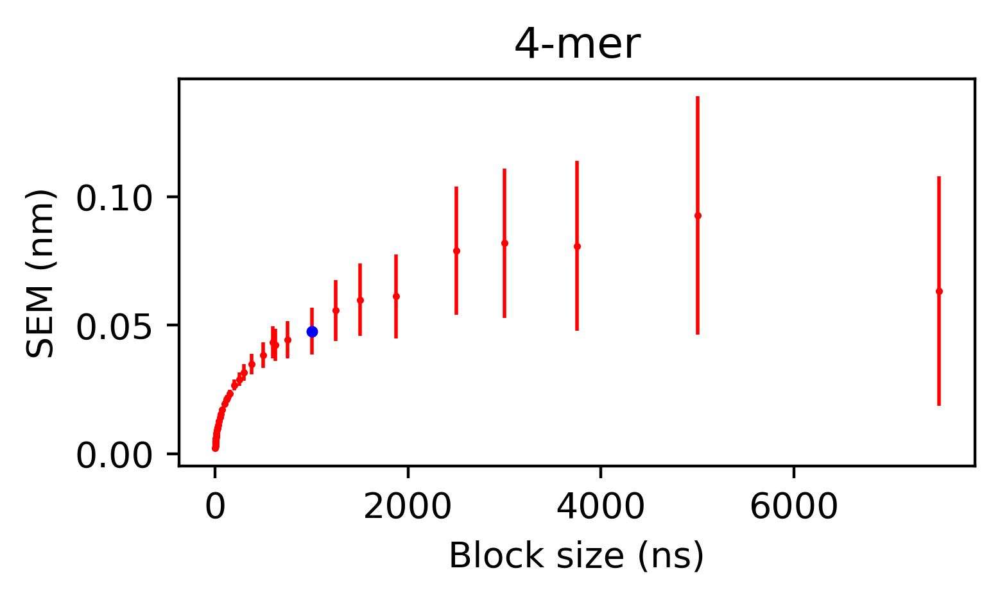

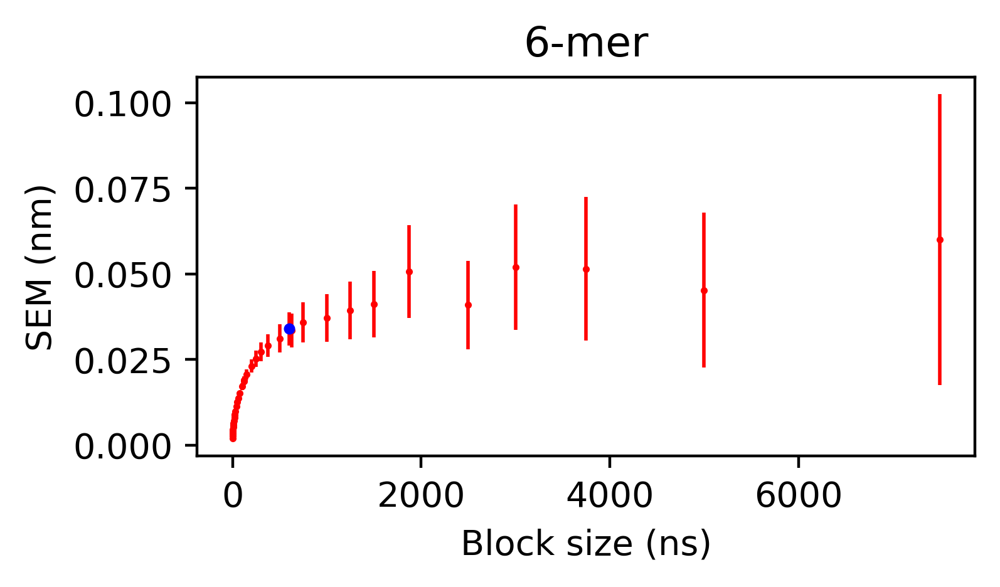

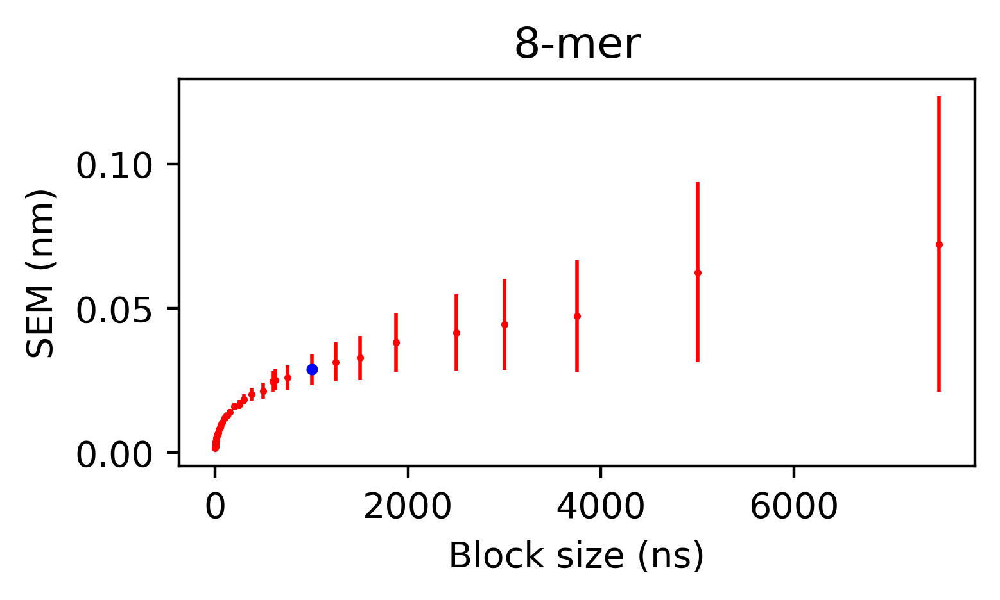

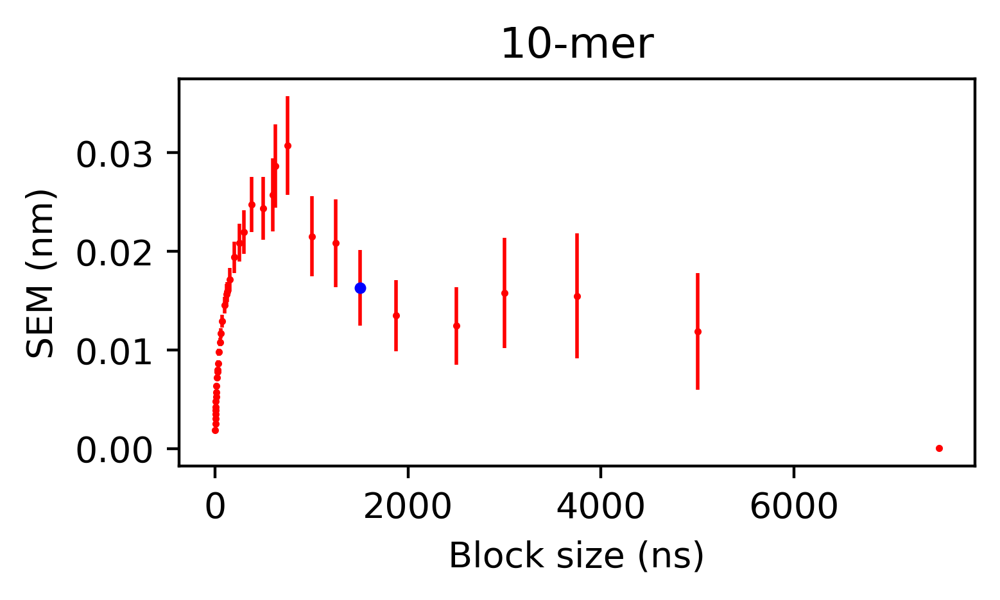

...

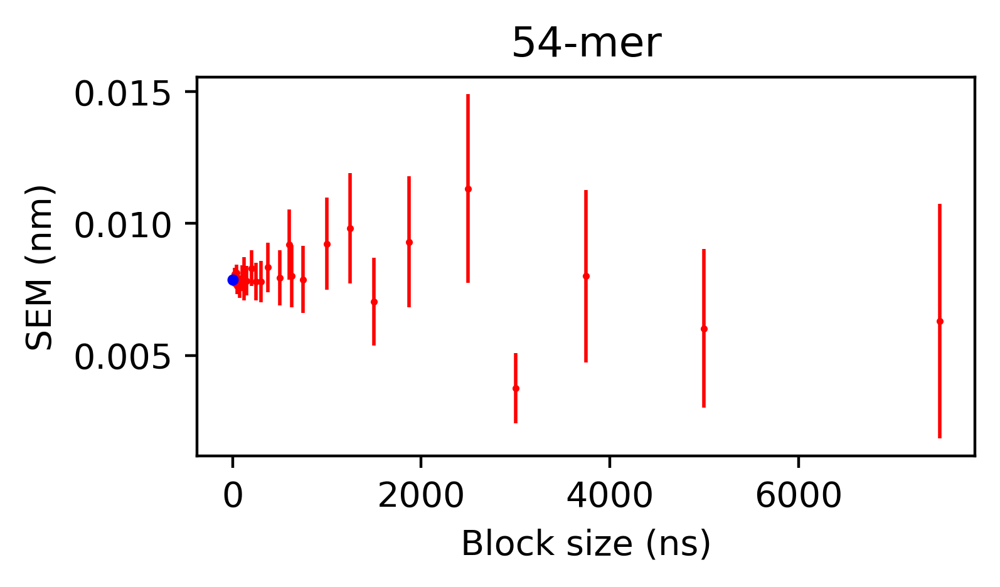

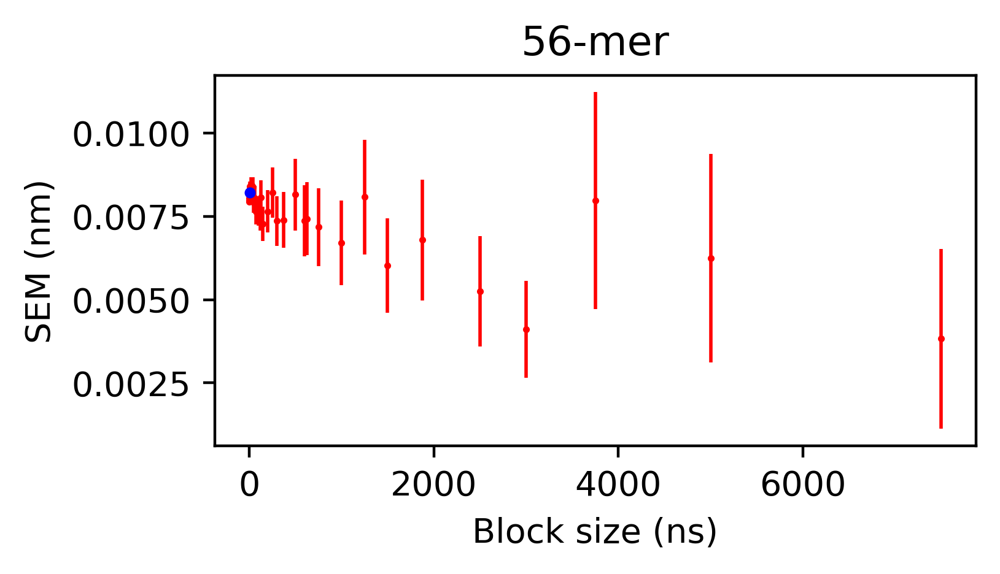

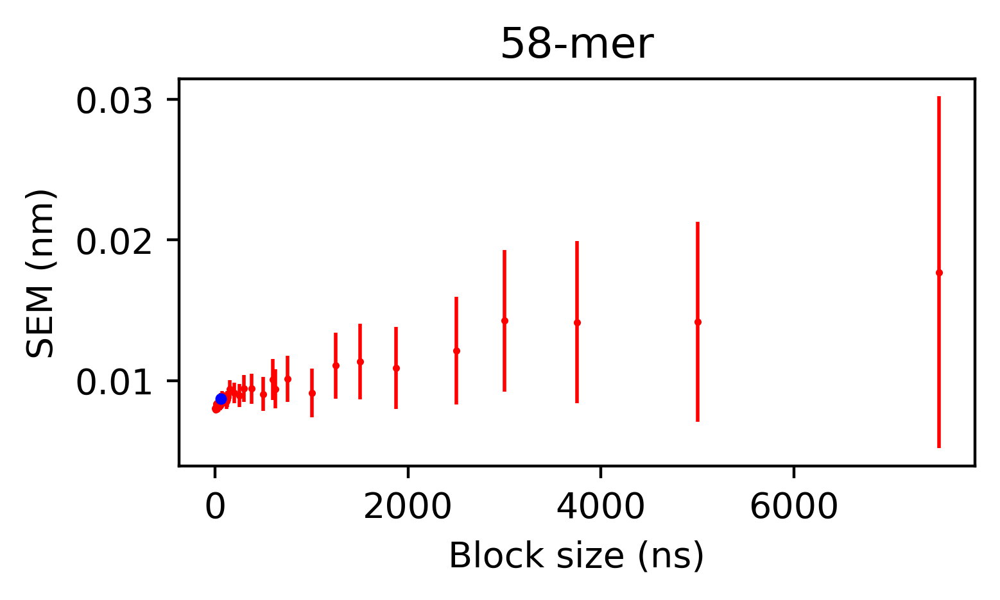

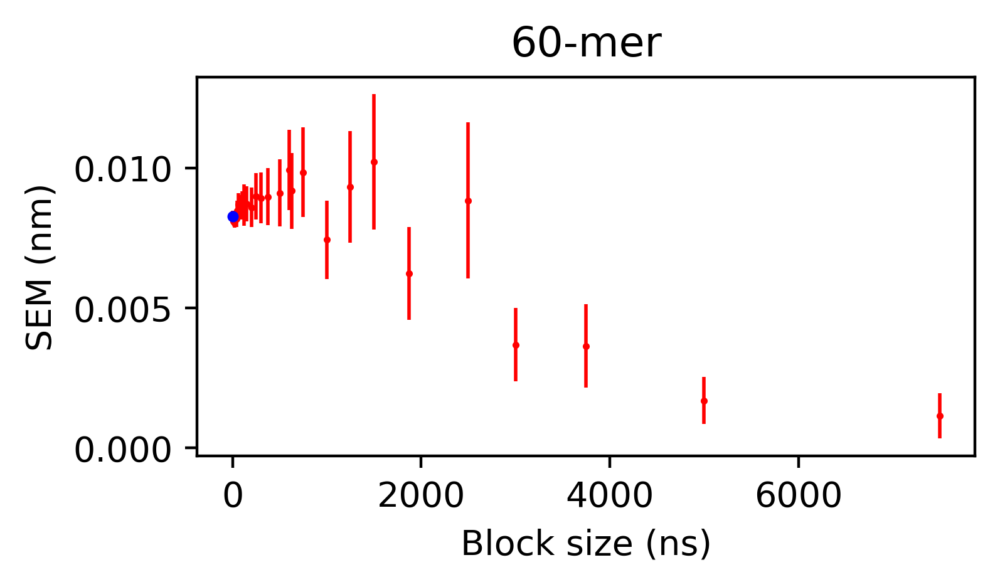

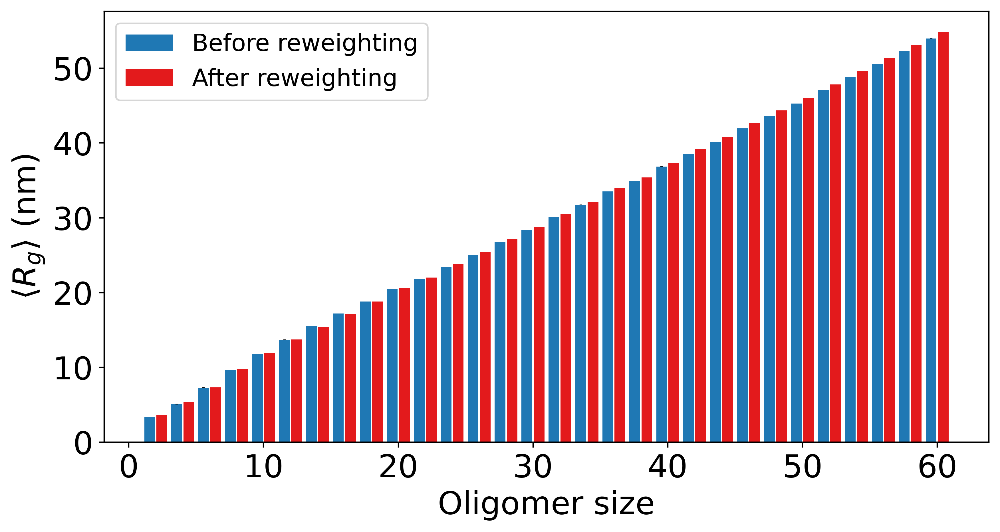

In [31]:
#Plot Rg averages
Rg_vs_size = []
Rg_rew_vs_size = []
Rg_blockerr_vs_size = []

#Loop over oligomer sizes
for i,size in enumerate(oligomersizes):
    
    #Get Rg
    time, Rg = np.genfromtxt(f'{MATH_type}_runs/SPOP_{size}mer/Rg_gyrate_AA.xvg', usecols=(0,1), skip_header=27, unpack=True)
    
    #Get avg
    Rg_avg = np.average(Rg)
    Rg_vs_size.append(Rg_avg)
    
    #Block error analysis
    corr_len, err, blocks_stat = block_err_analysis(Rg, errmethod)
    Rg_blockerr_vs_size.append(err)
    
    #Plot block error
    fig = plt.figure(figsize=(4, 2), dpi=400, facecolor='w')
    plt.title(f'{size}-mer')
    plt.xlabel('Block size (ns)')
    plt.ylabel('SEM (nm)')
    plt.errorbar(blocks_stat[...,0],blocks_stat[...,1],blocks_stat[...,2],fmt='ro',ms=1,elinewidth=1)
    plt.scatter(corr_len,err,c='blue',zorder=300,s=5)
    
    #Get avg with rew
    Rg_avg_rew = np.average(Rg, weights=weights_vs_size[i])
    Rg_rew_vs_size.append(Rg_avg_rew)

#Plot
fig = plt.figure(figsize=(10,5), dpi=400, facecolor='w')
plt.bar(oligomersizes-0.45, Rg_vs_size, yerr=Rg_blockerr_vs_size, color=colors[0], label='Before reweighting')
plt.bar(oligomersizes+0.45, Rg_rew_vs_size, color=colors[1], label='After reweighting')
plt.xlabel('Oligomer size', fontsize=20)
plt.ylabel('$⟨R_{g}⟩$ (nm)', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=20)
plt.legend(fontsize=15)

fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/Rg_avg_vs_size.pdf", bbox_inches='tight', pad_inches=1)

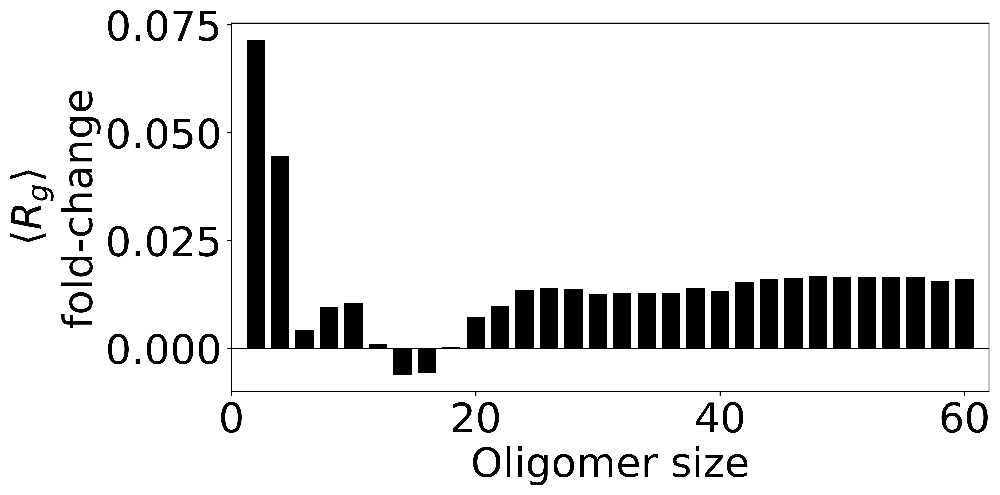

In [32]:
#Fold-change of average Rg after reweighting
Rg_rew_ratio = np.array(Rg_rew_vs_size)/np.array(Rg_vs_size)-1

#Plot
fig = plt.figure(figsize=(10,5), dpi=400)
plt.bar(oligomersizes, Rg_rew_ratio, width=1.5, color='black')
plt.axhline(0, linewidth=1, color='black')
plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('$⟨R_{g}⟩$\nfold-change', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.xlim(1, 62)
plt.xticks(np.arange(0,61,20))

fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/Rg_rew_ratio_vs_size.pdf", bbox_inches='tight', pad_inches=1)

# MATH - BTB/BACK distance

In [33]:
if recalculate == True:

    atoms_per_subunit = 5241 #AA
    atoms_per_MATH=2245 #AA, set up to (and with) 138VAL
    atoms_per_BTBBACK=2686 #AA, set from (and with) 160ARG to (and with) 334ALA
    
    def calculate_MATH_BTBBACK_dist(size):
        #Load traj
        traj = md.load(f'{MATH_type}_runs/SPOP_{size}mer/prodrun_AAbackmapped.xtc', top=f'{MATH_type}_runs/SPOP_{size}mer/prodrun_AAbackmapped.gro')

        #Calculate avg COM distance between MATH and BTB/BACK for each subunit
        dist_vs_subunit = []
        dist_avg_vs_subunit = []
        dist_err_vs_subunit = []
        dist_avg_rew_vs_subunit = []
        for subunit in range(1,size+1):
            print(f'Starting subunit {subunit}')
            
            #Slice MATH and BTB/BACK in subunit
            MATH_atoms = np.arange(atoms_per_subunit*(subunit-1),atoms_per_subunit*(subunit-1)+atoms_per_MATH)
            MATH_slice = md.Trajectory.atom_slice(traj, MATH_atoms)
            MATH_COM = md.compute_center_of_mass(MATH_slice)

            BTBBACK_atoms = np.arange(atoms_per_subunit*subunit-atoms_per_BTBBACK,atoms_per_subunit*subunit)
            BTBBACK_slice = md.Trajectory.atom_slice(traj, BTBBACK_atoms)
            BTBBACK_COM = md.compute_center_of_mass(BTBBACK_slice) 

            #Calculate COM distance for all frames
            dist = np.linalg.norm(MATH_COM-BTBBACK_COM,axis=1)

            #Block error analysis
            corr_len, err, blocks_stat = block_err_analysis(dist, errmethod)
            plt.fig = plt.figure(figsize=(4, 2), dpi=300, facecolor='w')
            plt.title(traj)
            plt.xlabel('Block size (ns)')
            plt.ylabel('SEM (nm)')
            plt.errorbar(blocks_stat[...,0],blocks_stat[...,1],blocks_stat[...,2],fmt='ro',ms=1,elinewidth=1)
            plt.scatter(corr_len,err,c='blue',zorder=300,s=5)
            
            #Append to lists
            dist_vs_subunit.append(dist)
            dist_err_vs_subunit.append(err)

        #Save pickles
        save_pickle(f'pickles/{MATH_type}/dist_vs_subunit_{size}mer.pkl', dist_vs_subunit)
        save_pickle(f'pickles/{MATH_type}/dist_err_vs_subunit_{size}mer.pkl', dist_err_vs_subunit)
    
    #Calculate MATH-BTBBACK distances (one thread for each oligomer size)
    assert len(oligomersizes)<mp.cpu_count()
    pool = mp.Pool(len(oligomersizes))
    pool.map(calculate_MATH_BTBBACK_dist, [size for size in oligomersizes])
    pool.close()
    pool.join()

In [34]:
dist_avg_all = []
dist_avg_rew_all = []
dist_all = np.array([])
weights_all = np.array([])
dist_fold_change_avg_vs_size = []

#Loop over oligomersizes
for i,size in enumerate(oligomersizes):
    
    #Load pickles
    dist_vs_subunit = load_pickle(f'pickles/{MATH_type}/dist_vs_subunit_{size}mer.pkl')
    dist_err_vs_subunit = load_pickle(f'pickles/{MATH_type}/dist_err_vs_subunit_{size}mer.pkl')
    
    #Get average distances for each subunit before and after reweighting
    dist_avg_vs_subunit = []
    dist_avg_rew_vs_subunit = []
    
    for dist in dist_vs_subunit:
        
        #Average distance
        dist_avg = np.average(dist)
        dist_avg_vs_subunit.append(dist_avg)
        dist_avg_all.append(dist_avg)
        
        #Weighted average distance
        dist_avg_rew = np.average(dist, weights=weights_vs_size[i])
        dist_avg_rew_vs_subunit.append(dist_avg_rew)
        dist_avg_rew_all.append(dist_avg_rew)
        
        #Get all distances and weights in flat array for histogram
        dist_all = np.concatenate((dist_all, dist))
        weights_all = np.concatenate((weights_all, weights_vs_size[i]))
    
    #Get avg fold change
    dist_fold_change_vs_subunit = np.array(dist_avg_rew_vs_subunit)/np.array(dist_avg_vs_subunit)
    dist_fold_change_avg = np.average(dist_fold_change_vs_subunit)-1.0
    dist_fold_change_avg_vs_size.append(dist_fold_change_avg)

#Renormalize flat array of weights
weights_all /= np.sum(weights_all)

In [35]:
#Functions to fit trimodal guassians

def gauss(x,mu,sigma,A):
    return A*np.exp(-(x-mu)**2/2/sigma**2)

def trimodal_gaussmix(x, mu1,sigma1,A1, mu2,sigma2,A2, mu3,sigma3,A3):
    return gauss(x,mu1,sigma1,A1) + gauss(x,mu2,sigma2,A2) + gauss(x,mu3,sigma3,A3)

def fit_trimodal_gaussmix(hist_x, hist_y, params_guess, lower_bound, upper_bound):
    
    #Get centers of hist bins from edges
    gaussians_x = []
    for i,histedge in enumerate(hist_x[:len(hist_x)-1]):
        gaussians_x.append((histedge + dist_all_hist[1][i+1])/2)
    gaussians_x = np.array(gaussians_x)
    
    #Define bounds
    lower_bounds = np.array([lower_bound]*9)
    upper_bounds = np.array([upper_bound]*9)
    
    #Fit curve
    popt, pcov = curve_fit(trimodal_gaussmix, gaussians_x, hist_y, p0=params_guess, maxfev=1000000000, bounds=(lower_bounds, upper_bounds))
    
    #Get y values of gaussian mix
    gaussians_y = trimodal_gaussmix(gaussians_x, popt[0], popt[1], popt[2], popt[3], popt[4], popt[5], popt[6], popt[7], popt[8])
    
    #Define fitted params
    mu1 = popt[0]
    sigma1 = popt[1]
    A1 = popt[2]
    mu2 = popt[3]
    sigma2 = popt[4]
    A2 = popt[5]
    mu3 = popt[6]
    sigma3 = popt[7]
    A3 = popt[8]


    return mu1, sigma1, A1, mu2, sigma2, A2, mu3, sigma3, A3, gaussians_x, gaussians_y

#Initial params for optimization
params_guess = np.array([3.7, 1.0, 0.4, 5.0, 1.0, 0.5, 7.3, 1.5, 0.2])


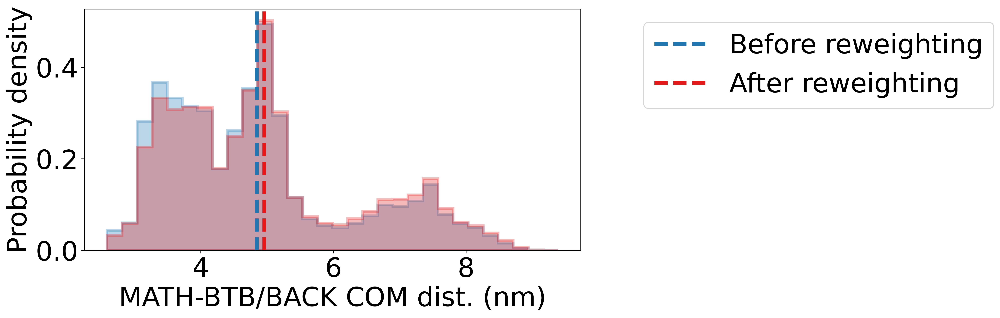

In [36]:
#All MATH-BTB/BACK distance histogram

#Start plot
fig = plt.figure(figsize=(10,5), dpi=400)
plt.xlabel('MATH-BTB/BACK COM dist. (nm)', fontsize=30)
plt.ylabel('Probability density', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

#Plot before reweighting
dist_all_hist = plt.hist(dist_all, density=True, color=colors[0], alpha=0.3, bins=30, histtype='stepfilled', edgecolor=colors[0], linewidth=3)

#plt.plot(kde_x, kde_y, '-', linewidth=4, alpha=0.7, color=colors[0])
plt.axvline(np.average(dist_all),linewidth=4, linestyle='--', alpha=1, color=colors[0], label='Before reweighting')

#Fit three gaussians and plot
mu1, sigma1, A1, mu2, sigma2, A2, mu3, sigma3, A3, gaussians_x, gaussians_y = fit_trimodal_gaussmix(dist_all_hist[1], dist_all_hist[0], params_guess, 0, 10)
gaussians_x = np.linspace(dist_all_hist[1][0]*0.85, dist_all_hist[1][-1]*1.15, num=500) 
gaussians_y = trimodal_gaussmix(gaussians_x, mu1,sigma1,A1, mu2,sigma2,A2, mu3,sigma3,A3)
#plt.plot(gaussians_x, gaussians_y, '-', linewidth=4, color=colors[0])

#Plot after reweighting
dist_all_hist_rew = plt.hist(dist_all, weights=weights_all, density=True, alpha=0.3, bins=30, color=colors[1], histtype='stepfilled', edgecolor=colors[1], linewidth=3)

#plt.plot(kde_x, kde_y, '-', linewidth=4, alpha=0.7, color=colors[1])
plt.axvline(np.average(dist_all, weights=weights_all),linewidth=4, linestyle='--', alpha=1, color=colors[1], label='After reweighting')

#Fit three gaussians and plot
mu1_rew, sigma1_rew, A1_rew, mu2_rew, sigma2_rew, A2_rew, mu3_rew, sigma3_rew, A3_rew, gaussians_x_rew, gaussians_y_rew = fit_trimodal_gaussmix(dist_all_hist_rew[1], dist_all_hist_rew[0], params_guess, 0, 10)
gaussians_x_rew = np.linspace(dist_all_hist[1][0]*0.85, dist_all_hist[1][-1]*1.15, num=500)
gaussians_y_rew = trimodal_gaussmix(gaussians_x_rew, mu1_rew, sigma1_rew, A1_rew, mu2_rew, sigma2_rew, A2_rew, mu3_rew, sigma3_rew, A3_rew)
#plt.plot(gaussians_x_rew, gaussians_y_rew, '-', linewidth=4, color=colors[1])

#Legend
plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.10, 1.0))

#Save
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/MATH_BTBBACK_distance_subunitshistogram.pdf", bbox_inches='tight', pad_inches=1)

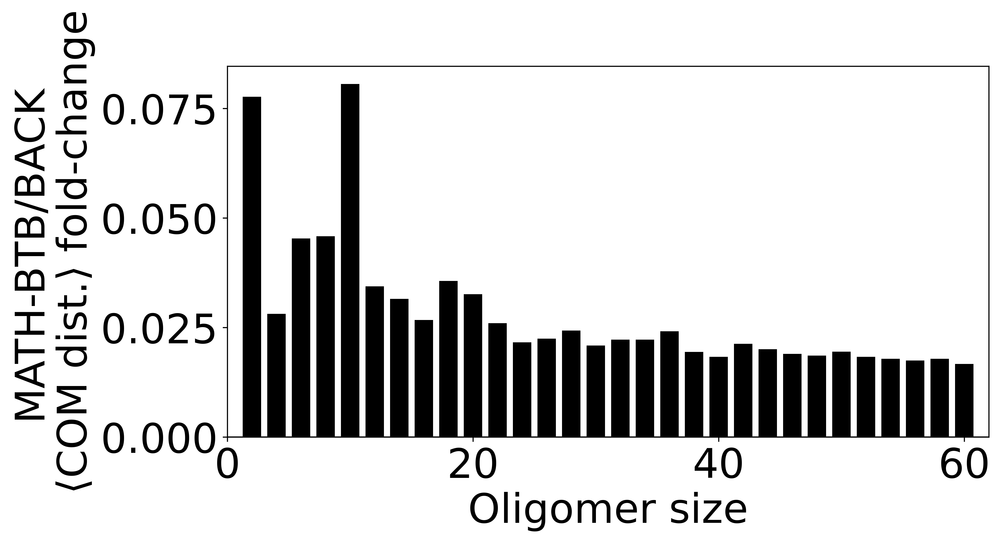

In [37]:
#Plot fold-change of average MATH-BTB/BACK dist after reweighting
fig = plt.figure(figsize=(10,5), dpi=400)
plt.bar(oligomersizes, dist_fold_change_avg_vs_size, width=1.5, color='black')
plt.axhline(0, linewidth=1, color='black')
plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('MATH-BTB/BACK\n⟨COM dist.⟩ fold-change', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.xlim(1, 62)
plt.xticks(np.arange(0,61,20))

fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/MATH_BTBBACK_distance_fold_change_vs_size.pdf", bbox_inches='tight', pad_inches=1)

## Get structures of three states in 12mer

In [38]:
#Load 12mer traj
traj_12mer = md.load(f'{MATH_type}_runs/SPOP_12mer/prodrun_AAbackmapped.xtc', top=f'{MATH_type}_runs/SPOP_12mer/prodrun_AAbackmapped.gro')

/lindorffgrp-isilon/thomasen/software/miniconda3/lib/python3.7/site-packages/mdtraj/formats/gro.py:307: UserWarning: WARNING: two consecutive residues with same number (SER, GLY)
  warnings.warn("WARNING: two consecutive residues with same number (%s, %s)" % (thisresname, residue.name))
/lindorffgrp-isilon/thomasen/software/miniconda3/lib/python3.7/site-packages/mdtraj/formats/gro.py:307: UserWarning: WARNING: two consecutive residues with same number (LYS, SER)
  warnings.warn("WARNING: two consecutive residues with same number (%s, %s)" % (thisresname, residue.name))
/lindorffgrp-isilon/thomasen/software/miniconda3/lib/python3.7/site-packages/mdtraj/formats/gro.py:307: UserWarning: WARNING: two consecutive residues with same number (VAL, LYS)
  warnings.warn("WARNING: two consecutive residues with same number (%s, %s)" % (thisresname, residue.name))
/lindorffgrp-isilon/thomasen/software/miniconda3/lib/python3.7/site-packages/mdtraj/formats/gro.py:307: UserWarning: WARNING: two consec

In [39]:
#Load pickle with MATH-BTB/BACK COM distances
dist_vs_subunit_12mer = load_pickle(f'pickles/{MATH_type}/dist_vs_subunit_12mer.pkl')

In [40]:
atoms_per_subunit = 5241 #AA

config1_count = 0
config2_count = 0
config3_count = 0

#Get topology of first subunit for later
traj_12mer_slice = traj_12mer.atom_slice(np.arange(0, atoms_per_subunit))
subunit1_top = traj_12mer_slice.top

#Loop through 10 internal subunits
i=1
for dist in dist_vs_subunit_12mer[1:len(dist_vs_subunit_12mer)-1]:
    
    print(i)
    
    #Get indeces of frames within 0.1*sigma of Gaussian means
    MATH_config1_indeces = np.where((dist > (mu1_rew - sigma1_rew/10)) & (dist < (mu1_rew + sigma1_rew/10)) == True)[0]
    MATH_config2_indeces = np.where((dist > (mu2_rew - sigma2_rew/10)) & (dist < (mu2_rew + sigma2_rew/10)) == True)[0]
    MATH_config3_indeces = np.where((dist > (mu3_rew - sigma3_rew/10)) & (dist < (mu3_rew + sigma3_rew/10)) == True)[0]
    
    #Count number of frames
    config1_count += len(MATH_config1_indeces)
    config2_count += len(MATH_config2_indeces)
    config3_count += len(MATH_config3_indeces)
    
    #Slice out subunit from traj
    traj_12mer_slice = traj_12mer.atom_slice(np.arange(i*atoms_per_subunit, (i+1)*atoms_per_subunit))
    #Change top to match first subunit
    traj_12mer_slice.top = subunit1_top
    
    #Get frames from traj using selected indeces
    traj_12mer_subunit_MATH_config1 = traj_12mer_slice[MATH_config1_indeces]
    traj_12mer_subunit_MATH_config2 = traj_12mer_slice[MATH_config2_indeces]
    traj_12mer_subunit_MATH_config3 = traj_12mer_slice[MATH_config3_indeces]
    
    #Add selected frames to new traj 
    if i==1:
        traj_12mer_MATH_config1 = traj_12mer_subunit_MATH_config1
        traj_12mer_MATH_config2 = traj_12mer_subunit_MATH_config2 
        traj_12mer_MATH_config3 = traj_12mer_subunit_MATH_config3

    else:
        traj_12mer_MATH_config1 = traj_12mer_subunit_MATH_config1.join(traj_12mer_MATH_config1)
        traj_12mer_MATH_config2 = traj_12mer_subunit_MATH_config2.join(traj_12mer_MATH_config2)
        traj_12mer_MATH_config3 = traj_12mer_subunit_MATH_config3.join(traj_12mer_MATH_config3)
    
    i+=1
    
assert len(traj_12mer_MATH_config1) == config1_count
assert len(traj_12mer_MATH_config2) == config2_count
assert len(traj_12mer_MATH_config3) == config3_count

#Save new trajs
os.system(f'mkdir {MATH_type}_runs/SPOP_12mer/MATH_configurations')
traj_12mer_MATH_config1.save_xtc(f'{MATH_type}_runs/SPOP_12mer/MATH_configurations/traj_12mer_MATH_config1.xtc')
traj_12mer_MATH_config1[0].save_gro(f'{MATH_type}_runs/SPOP_12mer/MATH_configurations/traj_12mer_MATH_config1.gro')
traj_12mer_MATH_config2.save_xtc(f'{MATH_type}_runs/SPOP_12mer/MATH_configurations/traj_12mer_MATH_config2.xtc')
traj_12mer_MATH_config2[0].save_gro(f'{MATH_type}_runs/SPOP_12mer/MATH_configurations/traj_12mer_MATH_config2.gro')
traj_12mer_MATH_config3.save_xtc(f'{MATH_type}_runs/SPOP_12mer/MATH_configurations/traj_12mer_MATH_config3.xtc')
traj_12mer_MATH_config3[0].save_gro(f'{MATH_type}_runs/SPOP_12mer/MATH_configurations/traj_12mer_MATH_config3.gro')

print(traj_12mer_MATH_config1)
print(traj_12mer_MATH_config2)
print(traj_12mer_MATH_config3)

1
2
3
4
5
6
7
8
9
10


mkdir: cannot create directory ‘MATHfree_runs/SPOP_12mer/MATH_configurations’: File exists


<mdtraj.Trajectory with 4658 frames, 5241 atoms, 334 residues, and unitcells>
<mdtraj.Trajectory with 4927 frames, 5241 atoms, 334 residues, and unitcells>
<mdtraj.Trajectory with 1885 frames, 5241 atoms, 334 residues, and unitcells>


# MATH-MATH bindingsite COMdist

In [41]:
MATH_MATHright_bindingsite_dist_avg_vs_subunit_vs_size = []
MATH_MATHright_bindingsite_dist_avg_rew_vs_subunit_vs_size = []
MATH_MATHright_bindingsite_dist_all = np.array([])
weights_all = np.array([])
MATH_MATHright_bindingsite_dist_fold_change_avg_vs_size = []

#Loop over oligomer sizes
for i,size in enumerate(oligomersizes):
      
    MATH_MATHright_bindingsite_dist_avg_vs_subunit = []
    MATH_MATHright_bindingsite_dist_avg_rew_vs_subunit = []
    
    #Loop over subunits in oligomer
    for subunit in range(1, size):
        
        #Load contacts from gmx file
        MATH_MATHright_bindingsite_dist = np.genfromtxt(f'{MATH_type}_runs/SPOP_{size}mer/MATH_MATH_bindingsite_distance/comdist_MATH_{subunit}_MATHright.xvg', usecols=(1), skip_header=17, unpack=True)
                
        #Average with uniform weights
        MATH_MATHright_bindingsite_dist_avg = np.average(MATH_MATHright_bindingsite_dist)
        MATH_MATHright_bindingsite_dist_avg_vs_subunit.append(MATH_MATHright_bindingsite_dist_avg)
        
        #Average with BME weights
        MATH_MATHright_bindingsite_dist_avg_rew = np.average(MATH_MATHright_bindingsite_dist, weights=weights_vs_size[i])
        MATH_MATHright_bindingsite_dist_avg_rew_vs_subunit.append(MATH_MATHright_bindingsite_dist_avg_rew)
        
        #Get all distances and weights in flat array for histogram
        MATH_MATHright_bindingsite_dist_all = np.concatenate((MATH_MATHright_bindingsite_dist_all, MATH_MATHright_bindingsite_dist))
        weights_all = np.concatenate((weights_all, weights_vs_size[i]))
        
    #Get avg fold change
    MATH_MATHright_bindingsite_dist_fold_change_vs_subunit = np.array(MATH_MATHright_bindingsite_dist_avg_rew_vs_subunit)/np.array(MATH_MATHright_bindingsite_dist_avg_vs_subunit)
    MATH_MATHright_bindingsite_dist_fold_change_avg = np.average(MATH_MATHright_bindingsite_dist_fold_change_vs_subunit)-1.0
    MATH_MATHright_bindingsite_dist_fold_change_avg_vs_size.append(MATH_MATHright_bindingsite_dist_fold_change_avg)
        
#Renormalize flat array of weights
weights_all /= np.sum(weights_all)

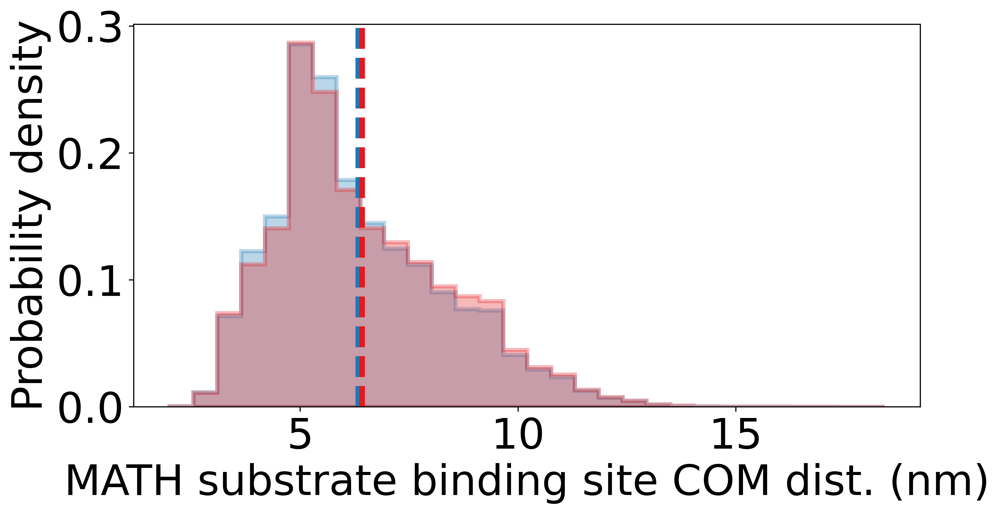

In [42]:
#All MATH-MATH binding site distance histogram

#Start plot
fig = plt.figure(figsize=(10,5), dpi=400)
plt.xlabel('MATH substrate binding site COM dist. (nm)', fontsize=30)
plt.ylabel('Probability density', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

#Plot before reweighting
plt.hist(MATH_MATHright_bindingsite_dist_all, density=True, color=colors[0], alpha=0.3, bins=30, histtype='stepfilled', edgecolor=colors[0], linewidth=3)
plt.axvline(np.average(MATH_MATHright_bindingsite_dist_all),linewidth=4, linestyle='--', alpha=1, color=colors[0], label='Before reweighting')

#Plot after reweighting
plt.hist(MATH_MATHright_bindingsite_dist_all, weights=weights_all, density=True, alpha=0.3, bins=30, color=colors[1], histtype='stepfilled', edgecolor=colors[1], linewidth=3)
plt.axvline(np.average(MATH_MATHright_bindingsite_dist_all, weights=weights_all),linewidth=4, linestyle='--', alpha=1, color=colors[1], label='After reweighting')

#Save
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/MATH_MATH_bindingsite_dist_histogram.pdf", bbox_inches='tight', pad_inches=1)

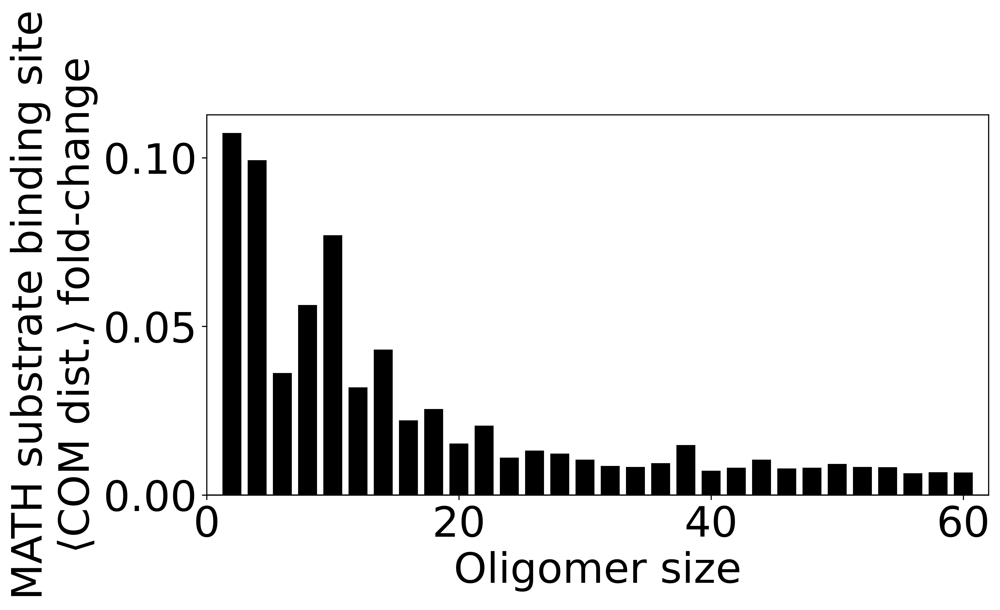

In [43]:
#Plot fold-change of average MATH-BTB/BACK dist after reweighting
fig = plt.figure(figsize=(10,5), dpi=400)
plt.bar(oligomersizes, MATH_MATHright_bindingsite_dist_fold_change_avg_vs_size, width=1.5, color='black')
plt.axhline(0, linewidth=1, color='black')
plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('MATH substrate binding site\n⟨COM dist.⟩ fold-change', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.xlim(1, 62)
plt.xticks(np.arange(0,61,20))

fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/MATH_MATH_bindingsite_dist_fold_change_vs_size.pdf", bbox_inches='tight', pad_inches=1)

# End to end distance and power law fit

In [44]:
if recalculate == True:

    atoms_per_subunit = 5241 #AA
    atoms_per_BTBBACK=2686 #AA, set from (and with) 160ARG to (and with) 334ALA
    
    def calculate_end2end_dist(size):
        #Load traj
        traj = md.load(f'{MATH_type}_runs/SPOP_{size}mer/prodrun_AAbackmapped.xtc', top=f'{MATH_type}_runs/SPOP_{size}mer/prodrun_AAbackmapped.gro')
        
        #Get COM of first subunit BTBBACK
        start_BTBBACK_atoms = np.arange(atoms_per_subunit-atoms_per_BTBBACK, atoms_per_subunit)
        start_BTBBACK_slice = md.Trajectory.atom_slice(traj, start_BTBBACK_atoms)
        start_BTBBACK_COM = md.compute_center_of_mass(start_BTBBACK_slice)
        
        #Get COM of last subunit BTBBACK
        end_BTBBACK_atoms = np.arange(atoms_per_subunit*size-atoms_per_BTBBACK, atoms_per_subunit*size)
        end_BTBBACK_slice = md.Trajectory.atom_slice(traj, end_BTBBACK_atoms)
        end_BTBBACK_COM = md.compute_center_of_mass(end_BTBBACK_slice)

        #Calculate COM distance for all frames
        e2e_dist = np.linalg.norm(start_BTBBACK_COM-end_BTBBACK_COM,axis=1)
        
        #Block error analysis
        corr_len, err, blocks_stat = block_err_analysis(dist, errmethod)
        plt.fig = plt.figure(figsize=(4, 2), dpi=300, facecolor='w')
        plt.title(traj)
        plt.xlabel('Block size (ns)')
        plt.ylabel('SEM (nm)')
        plt.errorbar(blocks_stat[...,0],blocks_stat[...,1],blocks_stat[...,2],fmt='ro',ms=1,elinewidth=1)
        plt.scatter(corr_len,err,c='blue',zorder=300,s=5)

        #Save pickles
        save_pickle(f'pickles/{MATH_type}/e2e_dist_{size}mer.pkl', e2e_dist)
        save_pickle(f'pickles/{MATH_type}/e2e_dist_err_{size}mer.pkl', err)
    
    #Calculate MATH-BTBBACK distances (one thread for each oligomer size)
    assert len(oligomersizes)<mp.cpu_count()
    pool = mp.Pool(len(oligomersizes))
    pool.map(calculate_end2end_dist, [size for size in oligomersizes])
    pool.close()
    pool.join()

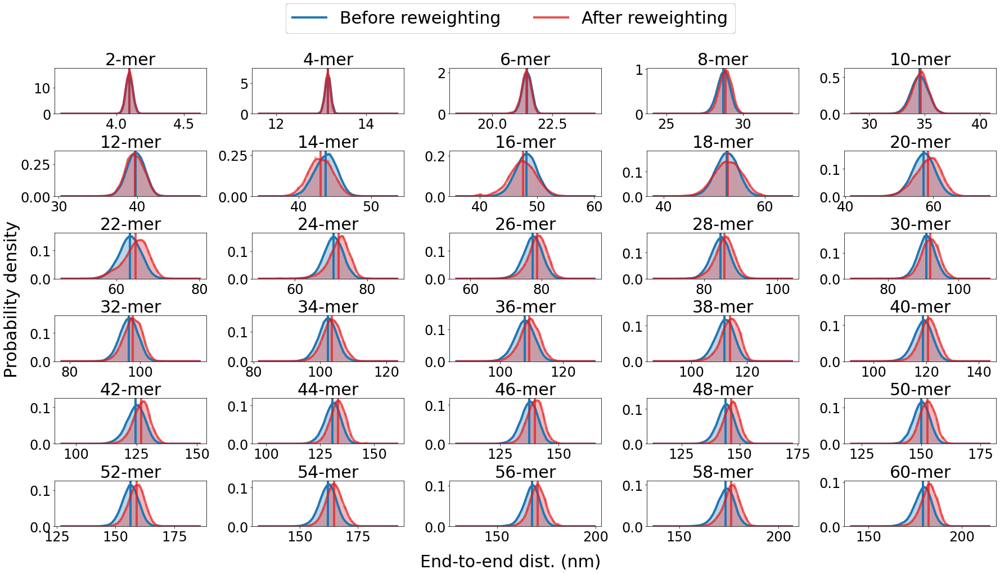

In [45]:
e2e_dist_avg_vs_size = []
e2e_dist_avg_rew_vs_size = []
e2e_dist_err_vs_size = []

#Start plot
fig, ax = plt.subplots(figsize=(30,15), nrows=6, ncols=5)    
plt.subplots_adjust(hspace = 0.8, wspace=0.3)
fig.text(0.5, 0.08, 'End-to-end dist. (nm)', ha='center', va='top', fontsize=30)
fig.text(0.09, 0.5, 'Probability density', ha='center', va='center', fontsize=30, rotation=90)

#Loop over oligomer sizes
k=0
n=0
for i,size in enumerate(oligomersizes):
    
    #Load pickles
    e2e_dist = load_pickle(f'pickles/{MATH_type}/e2e_dist_{size}mer.pkl')
    
    #Get avg
    e2e_dist_avg = np.average(e2e_dist)
    e2e_dist_avg_vs_size.append(e2e_dist_avg)
    
    #Get avg with reweighting
    e2e_dist_avg_rew = np.average(e2e_dist, weights=weights_vs_size[i])
    e2e_dist_avg_rew_vs_size.append(e2e_dist_avg_rew)
    
    e2e_dist_err = load_pickle(f'pickles/{MATH_type}/e2e_dist_err_{size}mer.pkl')
    e2e_dist_err_vs_size.append(e2e_dist_err)
    
    #Plot title
    ax[k,n].set_title(f'{size}-mer', fontsize=30)
    
    #KDE without weights
    kde_x = np.linspace( np.amin(e2e_dist)*0.9, np.amax(e2e_dist)*1.1, num = 50 )
    kde_y = stats.gaussian_kde(e2e_dist, bw_method = "silverman").evaluate(kde_x)
    
    #Plot distribution
    ax[k,n].hist(e2e_dist, density=True, color=colors[0], alpha=0.3, bins=30)
    ax[k,n].plot(kde_x, kde_y, '-', linewidth=4, color=colors[0])
    #Plot average
    if k==0 and n==0:
        ax[k,n].axvline(np.average(e2e_dist),linewidth=4, alpha=1, color=colors[0], label='Before reweighting')
    else:
        ax[k,n].axvline(np.average(e2e_dist),linewidth=4, alpha=1, color=colors[0])

    #KDE with weights
    kde_x = np.linspace( np.amin(e2e_dist)*0.9, np.amax(e2e_dist)*1.1, num = 100 )
    kde_y = stats.gaussian_kde(e2e_dist, bw_method = "silverman", weights=weights_vs_size[i]).evaluate(kde_x)
    
    #Plot distribution (with rew)
    ax[k,n].hist(e2e_dist, density=True, color=colors[1], alpha=0.3, bins=30, weights=weights_vs_size[i])
    ax[k,n].plot(kde_x, kde_y, '-', linewidth=4, color=colors[1], alpha=0.7)
    #Plot average (with rew)
    if k==0 and n==0:
        ax[k,n].axvline(np.average(e2e_dist, weights=weights_vs_size[i]),linewidth=4, alpha=0.7, color=colors[1], label='After reweighting')
    else:
        ax[k,n].axvline(np.average(e2e_dist, weights=weights_vs_size[i]),linewidth=4, alpha=0.7, color=colors[1])
    
    ax[k,n].tick_params(axis='both', which='major', labelsize=24)
    
    #Iterate over plot panel indeces
    n+=1
    if n==5:
        n=0
        k+=1

    #Add legend
    fig.legend(fontsize=30, loc='upper center', bbox_to_anchor=(0.5, 1.0), ncol=2)

    #Save
    fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/e2e_dist_distributions.pdf", bbox_inches='tight', pad_inches=1)


In [46]:
#Define e2e vs length power law
def e2e_dist_scaling(N, R0, v):
    return R0*(N**v)

In [47]:
#Fit e2e dist vs length power law
popt, pcov = curve_fit(e2e_dist_scaling, oligomersizes, e2e_dist_avg_vs_size)

R0 = popt[0]
scaling_exponent = popt[1]

print(f'Before reweighting: R0={R0}, v={scaling_exponent}')

#Fit e2e dist vs length power law (with rew)
popt_rew, pcov_rew = curve_fit(e2e_dist_scaling, oligomersizes, e2e_dist_avg_rew_vs_size)

R0_rew = popt_rew[0]
scaling_exponent_rew = popt_rew[1]

print(f'After reweighting: R0={R0_rew}, v rew={scaling_exponent_rew}')

Before reweighting: R0=3.15661083109658, v=0.9859020237102744
After reweighting: R0=3.107610736649922, v rew=0.9942522066581336


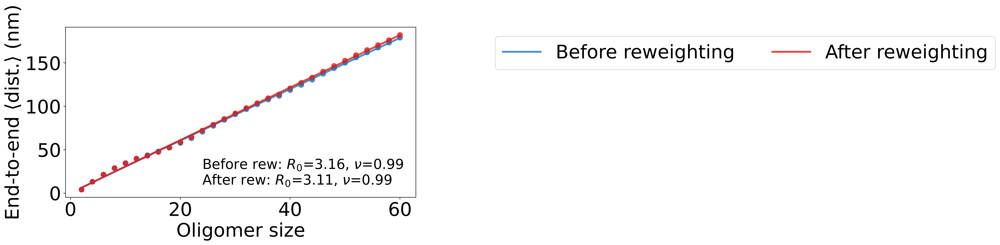

In [48]:
#Plot avg end-to-end dist vs oligomer size
fig = plt.figure(figsize=(10,5), dpi=400)

plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('End-to-end ⟨dist.⟩ (nm)', fontsize=30)

plt.tick_params(axis='both', which='major', labelsize=30)
plt.yticks(range(0,201,50))

#Plot points
plt.plot(oligomersizes, e2e_dist_avg_vs_size, 'o', markersize=8, color=colors[0], alpha=0.8)
plt.plot(oligomersizes, e2e_dist_avg_rew_vs_size, 'o', markersize=8, color=colors[1], alpha=0.8)

#Plot fits before and after rew
plotsteps = np.arange(oligomersizes[0], oligomersizes[-1], step=0.1)
plt.plot(plotsteps, e2e_dist_scaling(plotsteps, *popt), '-', linewidth=3, label='Before reweighting', alpha=0.8, color=colors[0])
plt.plot(plotsteps, e2e_dist_scaling(plotsteps, *popt_rew), '-', linewidth=3, label='After reweighting', alpha=0.8, color=colors[1])

plt.text(24,10, f'Before rew: $R_0$={R0:.2f}, $ν$={scaling_exponent:.2f}\nAfter rew: $R_0$={R0_rew:.2f}, $ν$={scaling_exponent_rew:.2f}', fontsize=22)
plt.legend(fontsize=30, ncol=2, bbox_to_anchor=(1.20, 1.0))
    
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/end2end_distance.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/end2end_distance.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


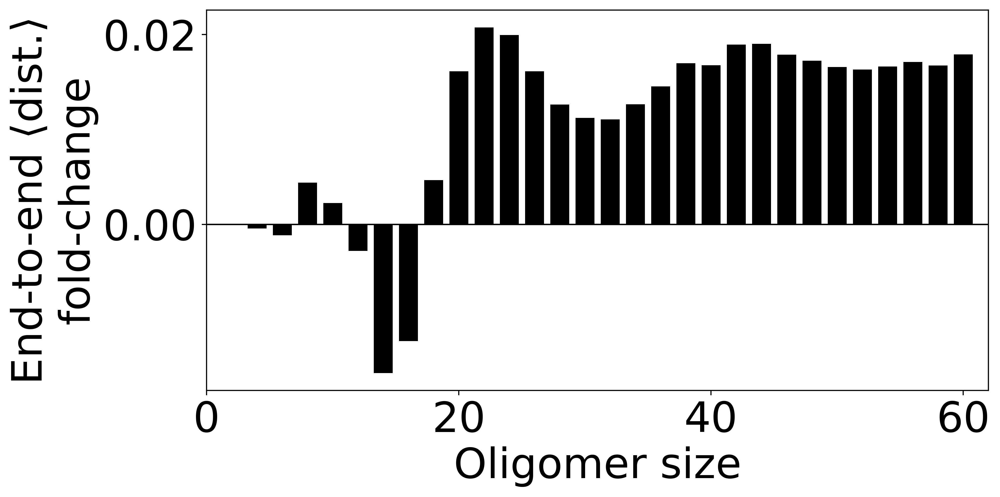

In [49]:
#Fold-change of average end-2-end distance after reweighting
e2e_dist_avg_rew_ratio = np.array(e2e_dist_avg_rew_vs_size)/np.array(e2e_dist_avg_vs_size)-1

#Plot
fig = plt.figure(figsize=(10,5), dpi=400)
plt.bar(oligomersizes, e2e_dist_avg_rew_ratio, width=1.5, color='black')
plt.axhline(0, linewidth=1, color='black')
plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('End-to-end ⟨dist.⟩\nfold-change', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.xlim(1, 62)
plt.xticks(np.arange(0,61,20))

fig.savefig(f"figures/{SPOP_type}/{reweighting_type}/e2e_distance_fold_change.pdf", bbox_inches='tight', pad_inches=1)

# MATHfree MATHfixed comparison





















In [50]:
#Make dir for MATHfree MATHfixed comparison
os.system(f'mkdir figures/MATHfree_MATHfixed_comparison')

mkdir: cannot create directory ‘figures/MATHfree_MATHfixed_comparison’: File exists


256

## Rg distributions

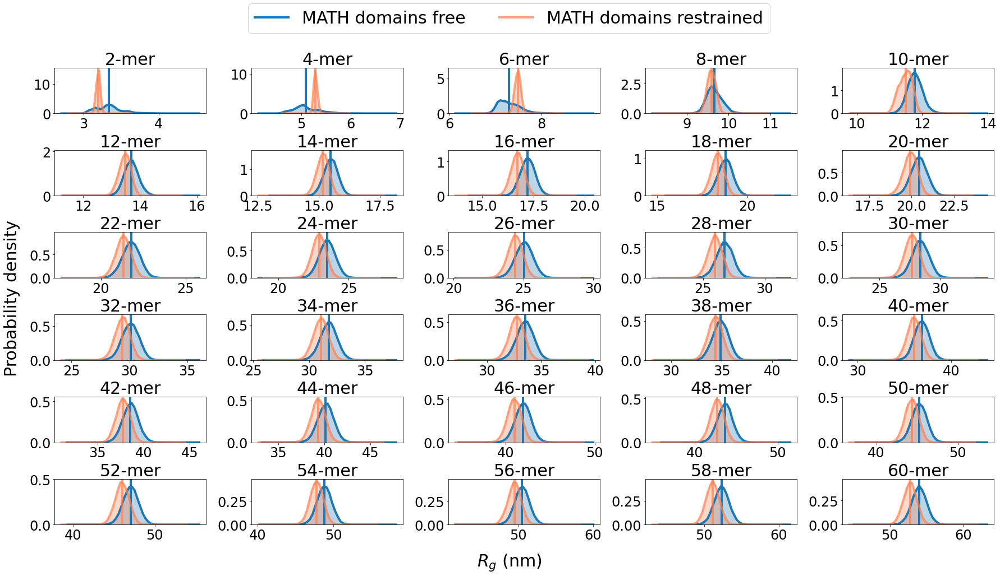

In [51]:
#Start plot
fig, ax = plt.subplots(figsize=(30,15), nrows=6, ncols=5)    
plt.subplots_adjust(hspace = 0.8, wspace=0.3)
fig.text(0.5, 0.08, '$R_g$ (nm)', ha='center', va='top', fontsize=30)
fig.text(0.09, 0.5, 'Probability density', ha='center', va='center', fontsize=30, rotation=90)

#Loop over oligomer sizes
k=0
n=0
for i,size in enumerate(oligomersizes):
    
    #Get Rg from gmx file
    time, Rg_MATHfree = np.genfromtxt(f'MATHfree_runs/SPOP_{size}mer/Rg_gyrate_AA.xvg', usecols=(0,1), skip_header=27, unpack=True)
    time, Rg_MATHfixed = np.genfromtxt(f'MATHfixed_runs/SPOP_{size}mer/Rg_gyrate_AA.xvg', usecols=(0,1), skip_header=27, unpack=True)
    
    #Plot title
    ax[k,n].set_title(f'{size}-mer', fontsize=30)
    
    #KDE MATHfree
    kde_x_MATHfree = np.linspace( np.amin(Rg_MATHfree)*0.9, np.amax(Rg_MATHfree)*1.1, num = 50 )
    kde_y_MATHfree = stats.gaussian_kde(Rg_MATHfree, bw_method = "silverman").evaluate(kde_x_MATHfree)
    
    #Plot MATHfree
    ax[k,n].hist(Rg_MATHfree, density=True, color=colors[0], alpha=0.3, bins=30)
    ax[k,n].plot(kde_x_MATHfree, kde_y_MATHfree, '-', linewidth=4, color=colors[0])
    if k==0 and n==0:
        ax[k,n].axvline(np.average(Rg_MATHfree),linewidth=4, alpha=1, color=colors[0], label='MATH domains free')
    else:
        ax[k,n].axvline(np.average(Rg_MATHfree),linewidth=4, alpha=1, color=colors[0])

    #KDE MATHfixed
    kde_x_MATHfixed = np.linspace( np.amin(Rg_MATHfixed)*0.9, np.amax(Rg_MATHfixed)*1.1, num = 50 )
    kde_y_MATHfixed = stats.gaussian_kde(Rg_MATHfixed, bw_method = "silverman").evaluate(kde_x_MATHfixed)
    
    #Plot MATHfixed
    ax[k,n].hist(Rg_MATHfixed, density=True, color=colors[3], alpha=0.3, bins=30)
    ax[k,n].plot(kde_x_MATHfixed, kde_y_MATHfixed, '-', linewidth=4, color=colors[3], alpha=0.7)
    if k==0 and n==0:
        ax[k,n].axvline(np.average(Rg_MATHfixed),linewidth=4, alpha=0.7, color=colors[3], label='MATH domains restrained')
    else:
        ax[k,n].axvline(np.average(Rg_MATHfixed), linewidth=4, alpha=0.7, color=colors[3])
    
    ax[k,n].tick_params(axis='both', which='major', labelsize=24)
    
    #Iterate over plot panel indeces
    n+=1
    if n==5:
        n=0
        k+=1

#Add legend
fig.legend(fontsize=30, loc='upper center', bbox_to_anchor=(0.5, 1.0), ncol=2)

#Save
fig.savefig(f"figures/MATHfree_MATHfixed_comparison/Rg_distributions.pdf", bbox_inches='tight', pad_inches=1)


/lindorffgrp-isilon/thomasen/software/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


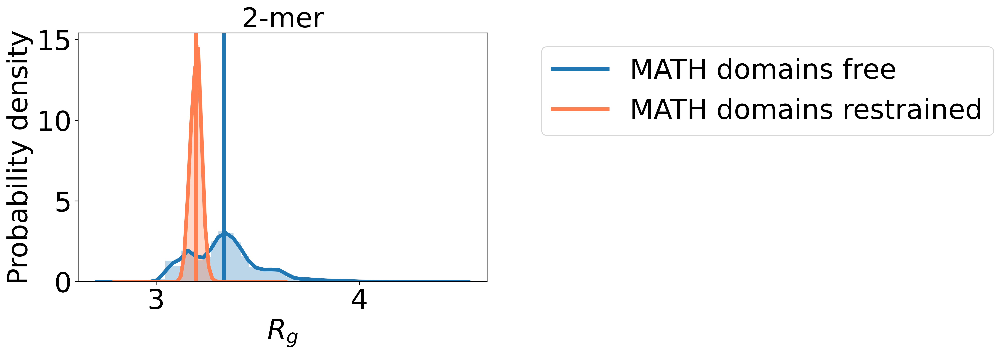

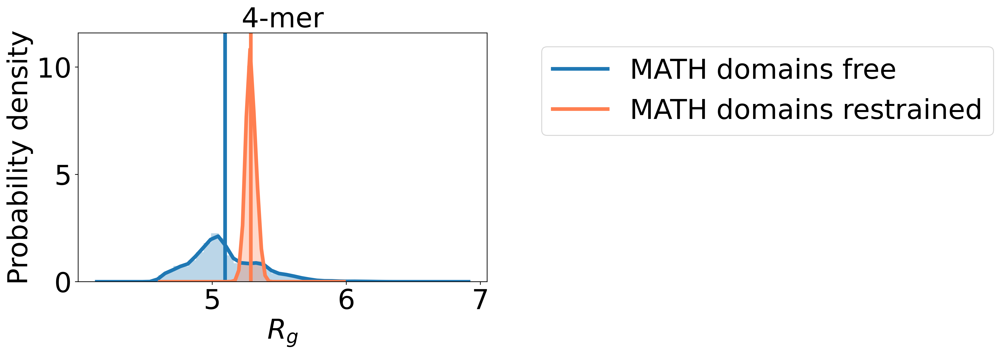

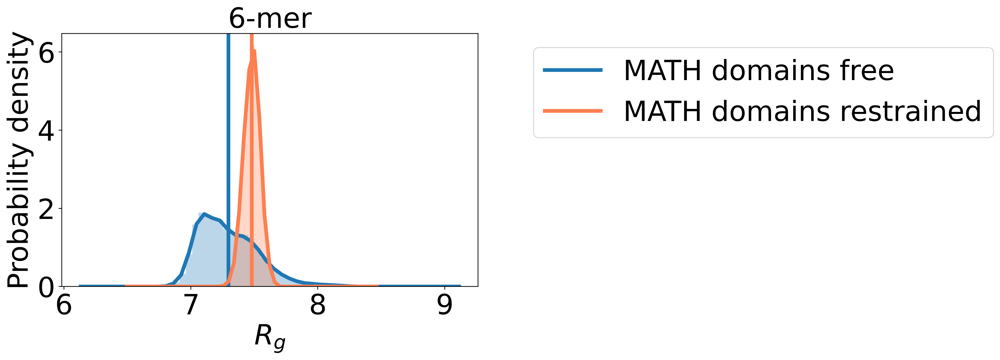

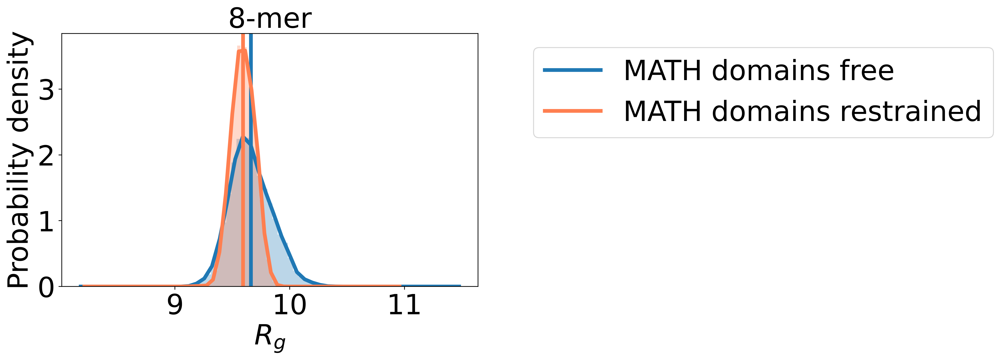

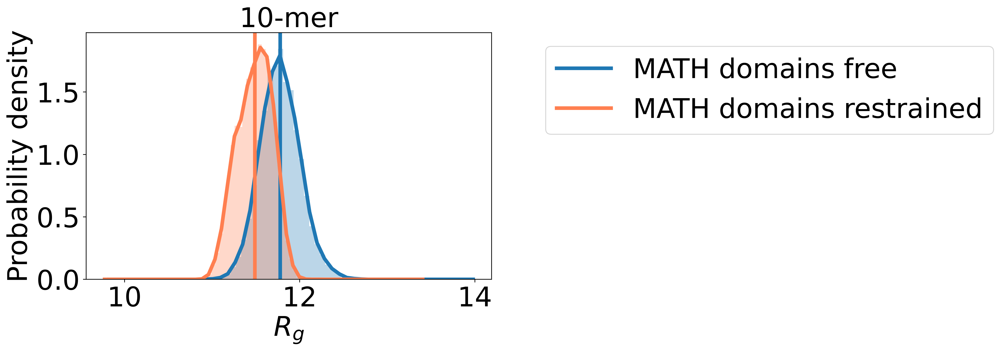

...

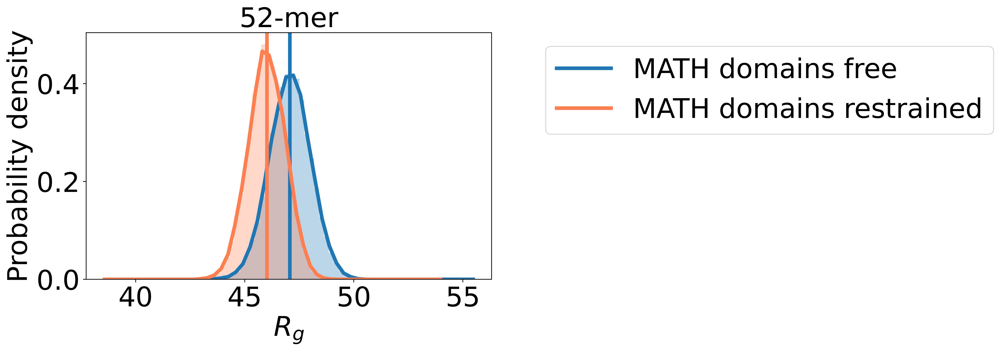

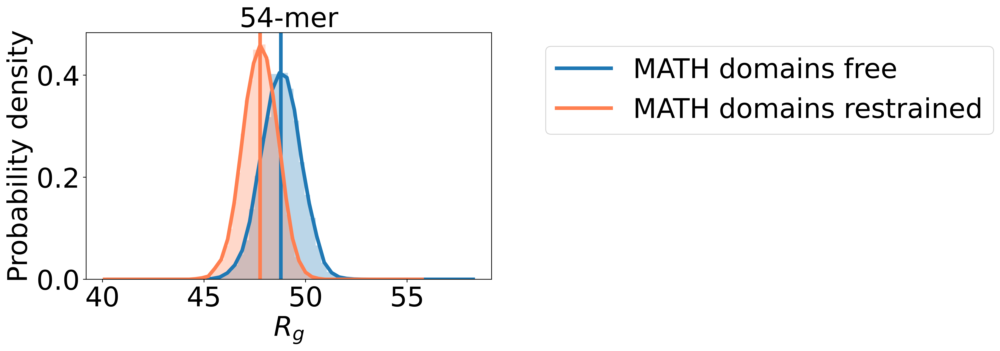

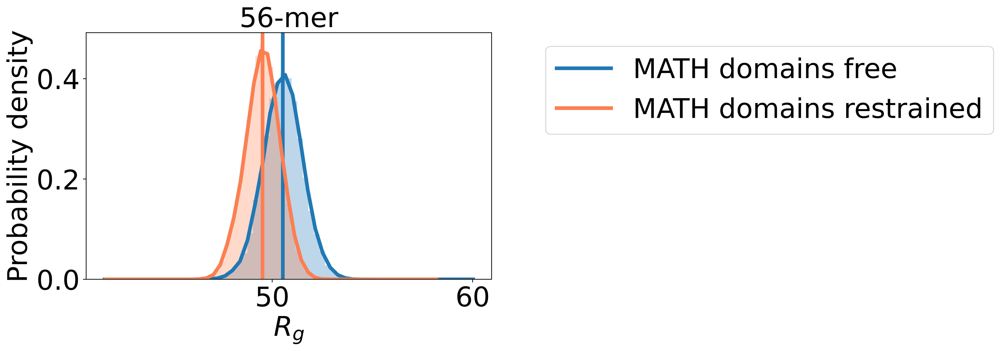

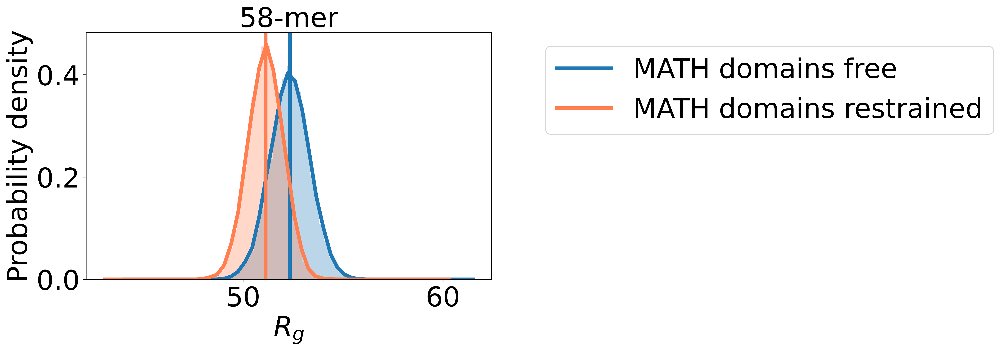

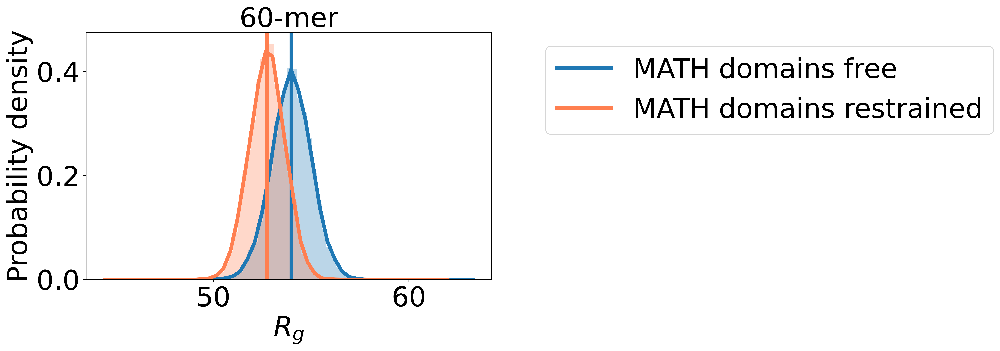

In [52]:
Rg_avg_vs_size_MATHfree = []
Rg_avg_vs_size_MATHfixed = []

for i,size in enumerate(oligomersizes):
    #Get Rg from file
    time, Rg_MATHfree = np.genfromtxt(f'MATHfree_runs/SPOP_{size}mer/Rg_gyrate_AA.xvg', usecols=(0,1), skip_header=27, unpack=True)
    time, Rg_MATHfixed = np.genfromtxt(f'MATHfixed_runs/SPOP_{size}mer/Rg_gyrate_AA.xvg', usecols=(0,1), skip_header=27, unpack=True)
    
    #Append averages to lists
    Rg_avg_vs_size_MATHfree.append(np.average(Rg_MATHfree))
    Rg_avg_vs_size_MATHfixed.append(np.average(Rg_MATHfixed))
    
    #Start plot
    fig = plt.figure(figsize=(8,5), dpi=400, facecolor='w')
    plt.title(f'{size}-mer', fontsize=30)
    plt.xlabel('$R_g$', fontsize=30)
    plt.ylabel('Probability density', fontsize=30)
    plt.tick_params(axis='both', which='major', labelsize=30)
    
    #KDE MATHfree
    kde_x_MATHfree = np.linspace( np.amin(Rg_MATHfree)*0.9, np.amax(Rg_MATHfree)*1.1, num = 50 )
    kde_y_MATHfree = stats.gaussian_kde(Rg_MATHfree, bw_method = "silverman").evaluate(kde_x_MATHfree)
    
    #Plot MATHfree
    plt.hist(Rg_MATHfree, density=True, alpha=0.3, bins=30, color=colors[0])
    plt.plot(kde_x_MATHfree, kde_y_MATHfree, '-', linewidth=4, color=colors[0])
    plt.axvline(np.average(Rg_MATHfree),linewidth=4, alpha=1, color=colors[0], label='MATH domains free')
    
    #KDE MATHfixed
    kde_x_MATHfixed = np.linspace( np.amin(Rg_MATHfixed)*0.9, np.amax(Rg_MATHfixed)*1.1, num = 50 )
    kde_y_MATHfixed = stats.gaussian_kde(Rg_MATHfixed, bw_method = "silverman").evaluate(kde_x_MATHfixed)
    
    #Plot MATHfixed
    plt.hist(Rg_MATHfixed, density=True, alpha=0.3, bins=30, color=colors[3])
    plt.plot(kde_x_MATHfixed, kde_y_MATHfixed, '-', linewidth=4, color=colors[3])
    plt.axvline(np.average(Rg_MATHfixed),linewidth=4, alpha=1, color=colors[3], label='MATH domains restrained')
    
    #Legend
    plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.10, 1.0))
        
    #Save
    fig.savefig(f"figures/MATHfree_MATHfixed_comparison/Rg_distributions/Rg_distribution_{size}mer.pdf", bbox_inches='tight', pad_inches=1)

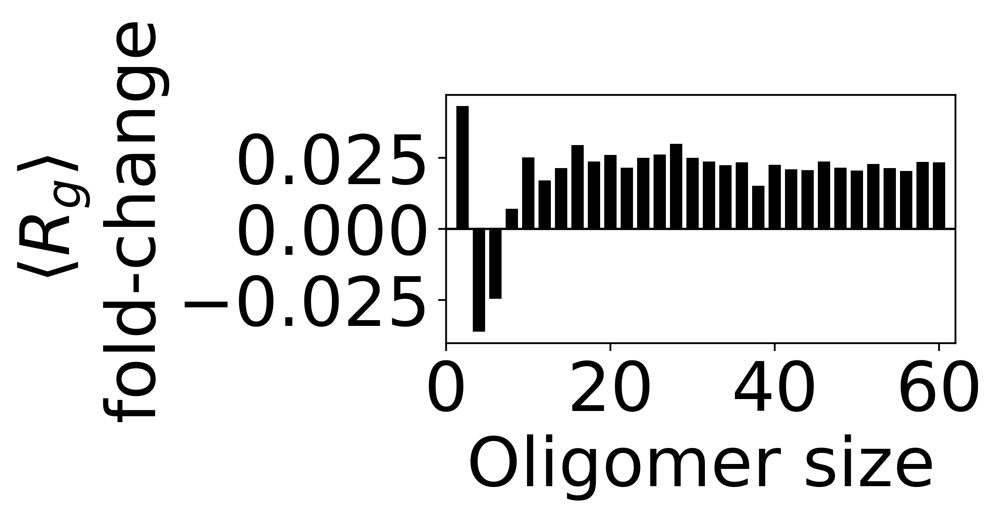

In [53]:
#Fold-change of average Rg from MATHfixed to MATHfree
Rg_ratio_MATHfree_MATHfixed = np.array(Rg_avg_vs_size_MATHfree)/np.array(Rg_avg_vs_size_MATHfixed)-1

#Plot
fig = plt.figure(figsize=(4,2), dpi=400)
plt.bar(oligomersizes, Rg_ratio_MATHfree_MATHfixed, width=1.5, color='black')
plt.axhline(0, linewidth=1, color='black')
plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('$⟨R_{g}⟩$\nfold-change', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.xlim(1, 62)
plt.xticks(np.arange(0,61,20))

fig.savefig(f"figures/MATHfree_MATHfixed_comparison/Rg_fold_change_vs_size.pdf", bbox_inches='tight', pad_inches=1)

## MATH - BTB/BACK distance

In [54]:
dist_avg_all_MATHfree = []
dist_avg_all_MATHfixed = []
dist_all_MATHfree = np.array([])
dist_all_MATHfixed = np.array([])
dist_fold_change_avg_vs_size_MATHfixed_MATHfree = []

#Loop over oligomer sizes
for i,size in enumerate(oligomersizes):
    
    #Load pickles
    dist_vs_subunit_MATHfree = load_pickle(f'pickles/MATHfree/dist_vs_subunit_{size}mer.pkl')
    dist_err_vs_subunit_MATHfree = load_pickle(f'pickles/MATHfree/dist_err_vs_subunit_{size}mer.pkl')
    
    dist_vs_subunit_MATHfixed = load_pickle(f'pickles/MATHfixed/dist_vs_subunit_{size}mer.pkl')
    dist_err_vs_subunit_MATHfixed = load_pickle(f'pickles/MATHfixed/dist_err_vs_subunit_{size}mer.pkl')
    
    #Get average distances for each subunit
    dist_avg_vs_subunit_MATHfree = []
    dist_avg_vs_subunit_MATHfixed = []
    
    #MATH free
    for dist in dist_vs_subunit_MATHfree:
        
        #Average distance
        dist_avg = np.average(dist)
        dist_avg_vs_subunit_MATHfree.append(dist_avg)
        dist_avg_all_MATHfree.append(dist_avg)
        dist_all_MATHfree = np.concatenate((dist_all_MATHfree, dist))
    
    #MATH fixed
    for dist in dist_vs_subunit_MATHfixed:
        
        #Average distance
        dist_avg = np.average(dist)
        dist_avg_vs_subunit_MATHfixed.append(dist_avg)
        dist_avg_all_MATHfixed.append(dist_avg)
        dist_all_MATHfixed = np.concatenate((dist_all_MATHfixed, dist))
        
    #Get avg fold change
    dist_fold_change_vs_subunit = np.array(dist_avg_vs_subunit_MATHfree)/np.array(dist_avg_vs_subunit_MATHfixed)
    dist_fold_change_avg = np.average(dist_fold_change_vs_subunit)-1.0
    dist_fold_change_avg_vs_size_MATHfixed_MATHfree.append(dist_fold_change_avg)


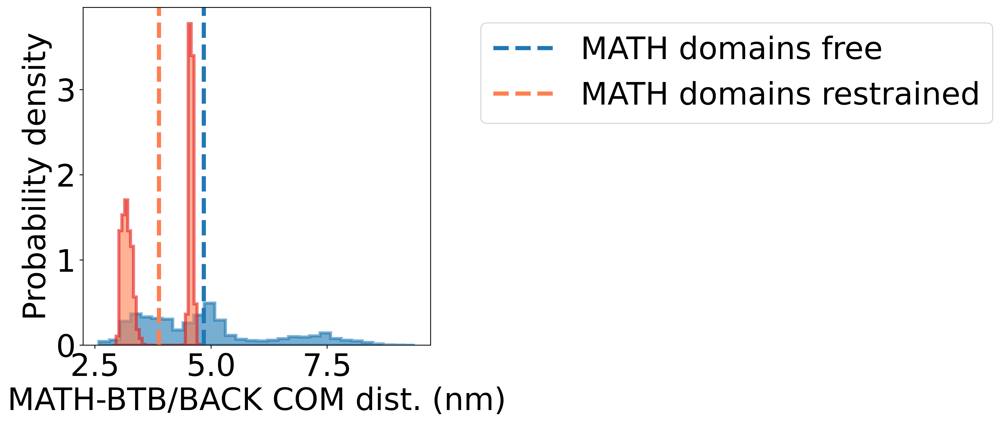

In [55]:
#All MATH-BTB/BACK distance histogram

#Start plot
fig = plt.figure(figsize=(6,6), dpi=400)
plt.xlabel('MATH-BTB/BACK COM dist. (nm)', fontsize=30)
plt.ylabel('Probability density', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

#Plot MATHfree
plt.hist(dist_all_MATHfree, density=True, color=colors[0], alpha=0.6, bins=30, histtype='stepfilled', edgecolor=colors[0], linewidth=3)
plt.axvline(np.average(dist_all_MATHfree), linewidth=4, linestyle='--', alpha=1, color=colors[0], label='MATH domains free')

#Plot MATHfixed
plt.hist(dist_all_MATHfixed, density=True, alpha=0.6, bins=30, color=colors[3], histtype='stepfilled', edgecolor=colors[1], linewidth=3)
plt.axvline(np.average(dist_all_MATHfixed), linewidth=4, linestyle='--', alpha=1, color=colors[3], label='MATH domains restrained')

#Legend
plt.legend(fontsize=30, ncol=1, bbox_to_anchor=(1.10, 1.0))

#Save
fig.savefig(f"figures/MATHfree_MATHfixed_comparison/MATH_BTBBACK_distance_subunitshistogram.pdf", bbox_inches='tight', pad_inches=1)

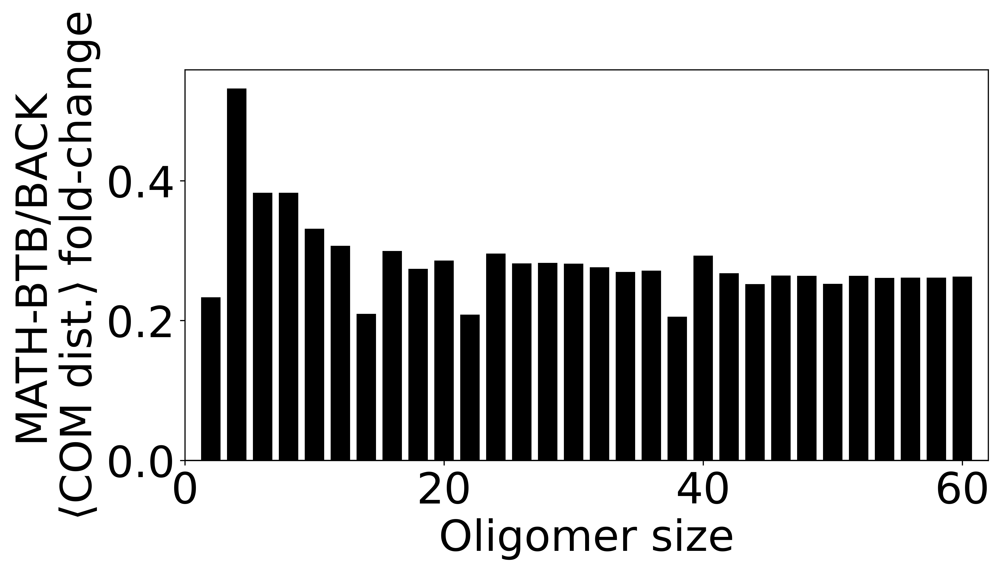

In [56]:
#Plot fold-change of average MATH-BTB/BACK dist from MATHfixed to MATHfree
fig = plt.figure(figsize=(10,5), dpi=400)
plt.bar(oligomersizes, dist_fold_change_avg_vs_size_MATHfixed_MATHfree, width=1.5, color='black')
plt.axhline(0, linewidth=1, color='black')
plt.xlabel('Oligomer size', fontsize=30)
plt.ylabel('MATH-BTB/BACK\n⟨COM dist.⟩ fold-change', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)
plt.xlim(1, 62)
plt.xticks(np.arange(0,61,20))

fig.savefig(f"figures/MATHfree_MATHfixed_comparison/MATH_BTBBACK_distance_fold_change.pdf", bbox_inches='tight', pad_inches=1)